In [31]:
import numpy as np
import pandas as pd
import scanpy as sc
import re
import anndata as ad

import gseapy as gp
from gseapy import dotplot
import time

from scipy.cluster.hierarchy import fcluster
from scipy.stats import ranksums
from scipy.stats.mstats import zscore
from statsmodels.stats.multitest import fdrcorrection

import seaborn as sns
sns.set_style("white")

pd.set_option('display.max_columns', None)
pd.set_option('display.max_rows', 500)

sc.settings.verbosity = 2  # reduce the verbosity
sc.logging.print_header()
sc.settings.set_figure_params(dpi=80, facecolor='white')

import warnings
warnings.filterwarnings('ignore')

scanpy==1.9.5 anndata==0.9.2 umap==0.5.3 numpy==1.21.5 scipy==1.9.1 pandas==1.4.4 scikit-learn==1.0.2 statsmodels==0.13.2 igraph==0.10.8 louvain==0.8.1 pynndescent==0.5.10


# Functions

In [3]:
# Read and filter data (basic)
def read_data(experiment ,path='data/raw-selected/KrasG12R_/sample_filtered_feature_bc_matrix',     
              cond_to_path_dict = {'G12C': 'data/Mix/G12C/sample_filtered_feature_bc_matrix/',
                                   'G12D': 'data/Mix/G12D/sample_filtered_feature_bc_matrix/',
                                   'G12R': 'data/J951_G12R_mix_GEX/filtered_feature_bc_matrix'},
              condition=None, replicate_num = None, cache=True, unique=True, filter_mat=True, cells=3, genes=150):
    
    if experiment == 'first':
        return read_data_1(condition=condition, cond_to_path_dict=cond_to_path_dict, replicate_num=replicate_num, 
                           cache=cache, unique=unique, filter_mat=filter_mat, cells=cells, genes=genes)
    elif experiment == 'second':
        return read_data_2(replicate_num=replicate_num, path=path, cache=cache, unique=unique, 
                           filter_mat=filter_mat, cells=cells, genes=genes)
    else:
        print('INCORRECT EXPERIMENT NUMBER!!!')


# Concatenate the two mixes (for G12C and G12D)
def read_data_1(condition, cond_to_path_dict = {'G12C': 'data/Mix/G12C/sample_filtered_feature_bc_matrix/',
                                                'G12D': 'data/Mix/G12D/sample_filtered_feature_bc_matrix/',
                                                'G12R': 'data/J951_G12R_mix_GEX/filtered_feature_bc_matrix'}, 
                replicate_num = None, cache=True, unique=True, filter_mat=True, cells=3, genes=150):
        
    if replicate_num is None:
        if condition == 'G12R':
            batch = condition
            adata = sc.read_10x_mtx(
                cond_to_path_dict[condition],
                var_names='gene_symbols',
                cache=cache)
                
            adata.obs.loc[:,'n_batch'] = batch

        elif condition == 'G12C' or condition == 'G12D':
            adata = None
            path = cond_to_path_dict[condition]
            for mix in [1,2]:
                for replicate in [1,2,3]:
                    batch = f'{condition}_{mix}_{replicate}'
                    p = re.sub('Mix', f'Mix{mix}', path)
                    p = re.sub(condition, f'{condition}_{replicate}', p)
                    print(f'Reading from {p}')
                    a = sc.read_10x_mtx(
                        p,
                        var_names='gene_symbols',
                        cache=cache)
                    a.obs.loc[:,'n_batch'] = batch

                    if adata:
                        adata = adata.concatenate(a)
                    else:
                        adata = a
                        
        else:
            adata = None
            path = cond_to_path_dict['G12C']
            for mix in [1,2]:
                for replicate in [1,2,3]:
                    batch = f'G12C_{mix}_{replicate}'
                    p = re.sub('Mix', f'Mix{mix}', path)
                    p = re.sub('G12C', f'G12C_{replicate}', p)
                    print(f'Reading from {p}')
                    a = sc.read_10x_mtx(
                        p,
                        var_names='gene_symbols',
                        cache=cache)
                    a.obs.loc[:,'n_batch'] = batch

                    if adata:
                        adata = adata.concatenate(a)
                    else:
                        adata = a
                        
            path = cond_to_path_dict['G12D']
            for mix in [1,2]:
                for replicate in [1,2,3]:
                    batch = f'G12D_{mix}_{replicate}'
                    p = re.sub('Mix', f'Mix{mix}', path)
                    p = re.sub('G12D', f'G12D_{replicate}', p)
                    print(f'Reading from {p}')
                    a = sc.read_10x_mtx(
                        p,
                        var_names='gene_symbols',
                        cache=cache)
                    a.obs.loc[:,'n_batch'] = batch

                    adata = adata.concatenate(a)

            batch = 'G12R'
            a = sc.read_10x_mtx(
                cond_to_path_dict['G12R'],
                var_names='gene_symbols',
                cache=cache)
            
            a.obs.loc[:,'n_batch'] = batch
            
            adata = adata.concatenate(a)

                
                        
    else:
        path1 = re.sub('Mix', 'Mix1', cond_to_path_dict[condition])
        path1 = re.sub(condition, f'{condition}_{replicate_num}', path1)
        
        path2 = re.sub('Mix', 'Mix2', cond_to_path_dict[condition])
        path2 = re.sub(condition, f'{condition}_{replicate_num}', path2)
        
        adata1 = sc.read_10x_mtx(
            path1,
            var_names='gene_symbols',
            cache=cache)
        
        adata1.obs.loc[:,'n_batch'] = f'{condition}_1_{replicate}'

        
        adata2 = sc.read_10x_mtx(
            path2,
            var_names='gene_symbols',
            cache=cache)
        
        adata1.obs.loc[:,'n_batch'] = f'{condition}_2_{replicate}'

        adata = adata1.concatenate(adata2)
    
    if unique:
        adata.var_names_make_unique()
    
    print(adata)
    
    sc.pl.highest_expr_genes(adata, n_top=20)

    if filter_mat:
        sc.pp.filter_cells(adata, min_genes=genes)
        sc.pp.filter_genes(adata, min_cells=cells)
        
        print(f'\nAfter filter:\n\n{adata}')
        
    return adata


def read_data_2(replicate_num = None, path='data/raw-selected/KrasG12R_/sample_filtered_feature_bc_matrix', cache=True, unique=True, filter_mat=True, cells=3, genes=150):
    
    if replicate_num is None:
        adata = None
        for replicate in [1,2,3]:
            batch = f'G12R_{replicate}'
            p = path
            p = re.sub('KrasG12R_', f'KrasG12R_{replicate}', p)
            print(f'Reading from {p}')
            a = sc.read_10x_mtx(
                p,
                var_names='gene_symbols',
                cache=cache)
            
            a.obs.loc[:,'n_batch'] = batch
            if adata:
                adata = adata.concatenate(a)
            else:
                adata = a
    else:
        path = re.sub('KrasG12R_', f'KrasG12R_{replicate_num}', path)
        batch = f'G12R_{replicate_num}'
        print(f'Reading from {path}')
        adata = sc.read_10x_mtx(
            path,
            var_names='gene_symbols',
            cache=cache)
        adata.obs.loc[:,'n_batch'] = batch


    if unique:
        adata.var_names_make_unique()
    
    print(adata)
    
    sc.pl.highest_expr_genes(adata, n_top=20)

    if filter_mat:
        sc.pp.filter_cells(adata, min_genes=genes)
        sc.pp.filter_genes(adata, min_cells=cells)
        
        print(f'\nAfter filter:\n\n{adata}')
        
    return adata


# filter mt genes and plot
def mt_initial_preprocess_and_plot(adata, var='mt', pattern='mt-', violin=True, scatter=True):
    adata.var[var] = adata.var_names.str.startswith(pattern)  # annotate the group of mitochondrial genes as 'mt'
    sc.pp.calculate_qc_metrics(adata, qc_vars=[var], percent_top=None, log1p=False, inplace=True)
    
    if violin:
        sc.pl.violin(adata, ['n_genes_by_counts', 'total_counts', 'pct_counts_mt'], jitter=0.4, multi_panel=True)
    
    if scatter:    
        sc.pl.scatter(adata, x='total_counts', y='pct_counts_mt')
        sc.pl.scatter(adata, x='total_counts', y='n_genes_by_counts')
    
    print('mt_initial_preprocess_and_plot shape')
    display(adata)
    return adata


# filter, normalize, logarithmize and scale
def preprocess(adata, n_genes_by_counts=5e4, pct_counts_mt=20, normalize=True, target_sum=1e4, 
                         logarithmize=True, dynamic=True, min_mean=1, max_mean=6, min_disp=0.4):
    adata = adata[adata.obs.n_genes_by_counts < n_genes_by_counts, :]
    adata = adata[adata.obs.pct_counts_mt < pct_counts_mt, :]
    print('preprocess shape')
    display(adata)

    if normalize:
        sc.pp.normalize_total(adata, target_sum=target_sum)
        
    if logarithmize:
        sc.pp.log1p(adata)
    
    if dynamic:
        sc.pp.highly_variable_genes(adata, min_mean=min_mean, max_mean=max_mean, min_disp=min_disp)

    sc.pl.highly_variable_genes(adata)

    adata.raw = adata
    adata = adata[:, adata.var.highly_variable]

    sc.pp.regress_out(adata, ['total_counts', 'pct_counts_mt'])

    sc.pp.scale(adata, max_value=10)

    return adata


# neighborhood graph
def neighborhood_graph_and_clustering(adata, n_neighbors=10, n_pcs=40, plot=False, color=['Sgk3'], use_raw=False, perplexity=10): # remove `plot=False` if you want to see the coarse-grained graph
    sc.tl.pca(adata, svd_solver='arpack')
    sc.pl.pca_variance_ratio(adata, log=True)

    sc.pp.neighbors(adata, n_neighbors=n_neighbors, n_pcs=n_pcs)
    
    sc.tl.louvain(adata)
    sc.tl.leiden(adata)
    sc.tl.tsne(adata, perplexity=perplexity, random_state=0)
    sc.pl.tsne(adata, color=color, use_raw=use_raw)

    sc.tl.paga(adata)
    sc.pl.paga(adata, plot=plot)  
    sc.tl.umap(adata, init_pos='paga', random_state=0)    
    sc.pl.umap(adata, color=color, use_raw=use_raw)

    return adata


def markers(adata, clusters='leiden', method='wilcoxon', n_genes=25): # Other possibilities are 'logreg' and 't-test'
    sc.tl.rank_genes_groups(adata, clusters, method=method)
    sc.pl.rank_genes_groups(adata, n_genes=n_genes, sharey=False)
    
    top_genes_df = pd.DataFrame(adata.uns['rank_genes_groups']['names']).head(20)

    return adata, top_genes_df


def reannotate_and_visualize_clusters(adata, cluster_map):
    adata.obs['leiden'] = adata.obs['leiden'].astype(int).replace(cluster_map)
    sc.pl.tsne(adata, color=['leiden'], use_raw=True, palette='Set1')
    
    return adata


def reannotate_subset_and_visualize(adata, adata_sub, cluster_map_sub, palette=None):
    adata_sub_names = adata_sub.obs['leiden'].astype(int).replace(cluster_map_sub)
    names = pd.concat([adata.obs['leiden'],(adata_sub_names)]).to_frame().reset_index().drop_duplicates(subset=['index'], keep='last').set_index('index')
    adata.obs = adata.obs.merge(names, left_index=True, right_index=True).drop(columns=['leiden_x']).rename({'leiden_y': 'leiden'}, axis=1)
    fig = sc.pl.tsne(adata, color=['leiden'], use_raw=True, palette=palette, return_fig=True)
    
    return adata, fig


def subset_analysis(adata, subset, clust_method = 'leiden', perplexity=30, color=['leiden'], use_raw=True, resolution=1):
    subset_clusters = [sub for sub in adata.obs['leiden'].unique() if subset.lower() in sub.lower()]
    adata_subset = adata[adata.obs['leiden'].isin(subset_clusters)]
    
    if clust_method == 'leiden':
        sc.tl.leiden(adata_subset,resolution=resolution)
    else:
        sc.tl.louvain(adata_subset,resolution=resolution)
    sc.tl.tsne(adata_subset, perplexity=perplexity, random_state=0)
    sc.pl.tsne(adata_subset, color=color, use_raw=use_raw)
    
    return adata_subset


def cohen_d(x, y):
    nx = len(x)
    ny = len(y)
    dof = nx + ny - 2
    
    return (np.mean(x) - np.mean(y)) / np.sqrt(((nx-1)*np.std(x, ddof=1) ** 2 + (ny-1)*np.std(y, ddof=1) ** 2) / dof)


def get_subset_indices(adata, cluster, cond='leiden'):
    obs_sub = adata.obs_names[adata.obs[cond].astype(int)==cluster]
    obs_rest = adata.obs_names[~adata.obs_names.isin(obs_sub)]
    
    obs_df = adata.obs.reset_index()
    sub_ind = obs_df[obs_df['index'].isin(obs_sub)].index.tolist()
    rest_ind = obs_df[obs_df['index'].isin(obs_rest)].index.tolist()

    return sub_ind, rest_ind


def calc_pval_and_effect(mat, sub_inds, rest_inds, gene_ind):
    samp1 = mat[sub_inds, gene_ind]
    samp2 = mat[rest_inds, gene_ind]

    pval = ranksums(samp1, samp2).pvalue
    effect = cohen_d(samp1, samp2)
    
    return pval, effect


def pval_and_effect_df(adata, cluster):
    df_diff = pd.DataFrame(index=adata.var_names, columns=['pval', 'effect'])
    sub_inds, rest_inds = get_subset_indices(adata, cluster)
    for i, gene in enumerate(df_diff.index):
        pval, effect = calc_pval_and_effect(adata.X, sub_inds, rest_inds, i)
        df_diff.loc[gene, ['pval', 'effect']] = [pval, effect]
    df_diff['fdr'] = fdrcorrection(df_diff['pval'])[1]
    
    return df_diff


def differential_genes(df, fdr=0.05, effect=0.5):
    diff_genes = df[np.logical_and(df['fdr']<fdr, np.abs(df['effect'])>effect)]['effect'].to_frame().sort_values(by='effect',ascending=False)
    diff_genes['effect'] = diff_genes['effect'].astype('float')
    diff_genes.index = diff_genes.index.str.upper()

    return diff_genes


def gsea_plot(diff_df, 
              title,
              ofname=None,
              gene_sets=['MSigDB_Oncogenic_Signatures','GO_Biological_Process_2023','GO_Molecular_Function_2023','KEGG_2021_Human','MSigDB_Hallmark_2020'], 
              threads=4,
              min_size=5,
              max_size=1000,
              permutation_num=1000, # reduce number to speed up testing
              outdir=None, # don't write to disk
              seed=6,
              verbose=False,
              column="NOM p-val",
              size=5,
              figsize=(10,10), 
              cutoff=1):
    
    pre_res = gp.prerank(rnk=diff_df, gene_sets=gene_sets, threads=threads, min_size=min_size, max_size=max_size, 
                         permutation_num=permutation_num, outdir=outdir, seed=seed, verbose=verbose)
    
    dotplot(pre_res.res2d, title=title, ofname=ofname, column=column, size=size, figsize=figsize, cutoff=cutoff)
    
    
def pathway_preprocess(adata, pathway_name, gene_list):
    print(f'adata shape: {adata.shape}')
    df_raw = pd.DataFrame.sparse.from_spmatrix(adata.raw.X, index=adata.raw.obs_names, columns=adata.raw.var_names)
    
    print(f'raw adata shape: {df_raw.shape}')
    print(f'Number of genes in pathway: {len(gene_list)}')
    
    df_genes = df_raw[df_raw.columns[df_raw.columns.isin(gene_list)]].sparse.to_dense()
    print(f'Number of pathway genes in DF: {(df_genes.shape[1])}')
    
    df_z = df_genes.apply(zscore)
    
    cancer_cells = adata[adata.obs['leiden'] == 'Cancer'].obs_names
    print(f'Number of cancer cells: {len(cancer_cells)}')
    
    df_z_cancer = df_z.loc[cancer_cells,:]
    print(f'Shape of cancer pathway DF: {df_z_cancer.shape}')

    df_cancer = df_z_cancer.mean(axis=1)
    df_cancer.name = pathway_name
    
    return df_cancer.to_frame()

## Parameters

In [4]:
conditions = ['G12C', 'G12D', 'G12R']

marker_genes = ['Krt19', 'Try4', 'Pecam1', 'Col1a2', 'Ptprc', 
                'Cd68', 'Cd163', 'Cd14', 'S100a8', 'Cd3e', 
                'Cd4', 'Cd8a', 'Kit', 'Mki67', 
                'Vwf', 'H2-Eb1', 'Sox4', 'Sox9', 'Try5', 
                'Try10', 'Muc4', 'Tm4sf1', 'Cpa1', 'Ins1', 
                'Ins2', 'Gcg', 'Pdgfrb', 'Tpsab1', 'Cpa3', 
                'Itgae', 'Nkg7', 'Il10', 'Arg1', 'Il6', 
                'Tnfsf10', 'Inhba', 'Il2ra']

marker_genes_immune = ['Krt19', 'Pecam1', 'Vwf', 'Col1a2', 'Ptprc', 
                       'Cd19', 'Cd68', 'Cd14', 'Cd163', 'Il6', 
                       'Inhba', 'Arg1', 'S100a8', 'Cd3e', 'Tnf',
                       'Try4', 'Try5', 'Try10', 'Cpa1', 'Tm4sf1', 
                       'Sox4', 'Sox9', 'H2-Eb1', 'Muc4', 'Cd4', 
                       'Cd8a', 'Il2ra', 'Kit', 'Mki67', 'Ins1', 
                       'Pdgfrb', 'Tpsab1', 'Cpa3', 'Itgae', 'Nkg7']

colors = {'Macrophages M2':'#800000', 
          'MDSCs':'#9A6324', 
          'B-cells':'#f58231', 
          'Cd4 T-cells':'#469990', 
          'Cd8 T-cells':'#000075', 
          'Fibroblasts':'#e6194B', 
          'Macrophages M1':'#ffe119',
          'Cancer':'#3cb44b',
          'Acinar':'#42d4f4',
          'Endothelial':'#911eb4',
          'Fibroblasts (stellate)':'#f032e6'}

## Run pipeline

Running G12C
----------------------------------------------------------------------------

Reading from data/Mix1/G12C_1/sample_filtered_feature_bc_matrix/
... reading from cache file cache/data-Mix1-G12C_1-sample_filtered_feature_bc_matrix-matrix.h5ad
Reading from data/Mix1/G12C_2/sample_filtered_feature_bc_matrix/
... reading from cache file cache/data-Mix1-G12C_2-sample_filtered_feature_bc_matrix-matrix.h5ad
Reading from data/Mix1/G12C_3/sample_filtered_feature_bc_matrix/
... reading from cache file cache/data-Mix1-G12C_3-sample_filtered_feature_bc_matrix-matrix.h5ad
Reading from data/Mix2/G12C_1/sample_filtered_feature_bc_matrix/
... reading from cache file cache/data-Mix2-G12C_1-sample_filtered_feature_bc_matrix-matrix.h5ad
Reading from data/Mix2/G12C_2/sample_filtered_feature_bc_matrix/
... reading from cache file cache/data-Mix2-G12C_2-sample_filtered_feature_bc_matrix-matrix.h5ad
Reading from data/Mix2/G12C_3/sample_filtered_feature_bc_matrix/
... reading from cache file cache/

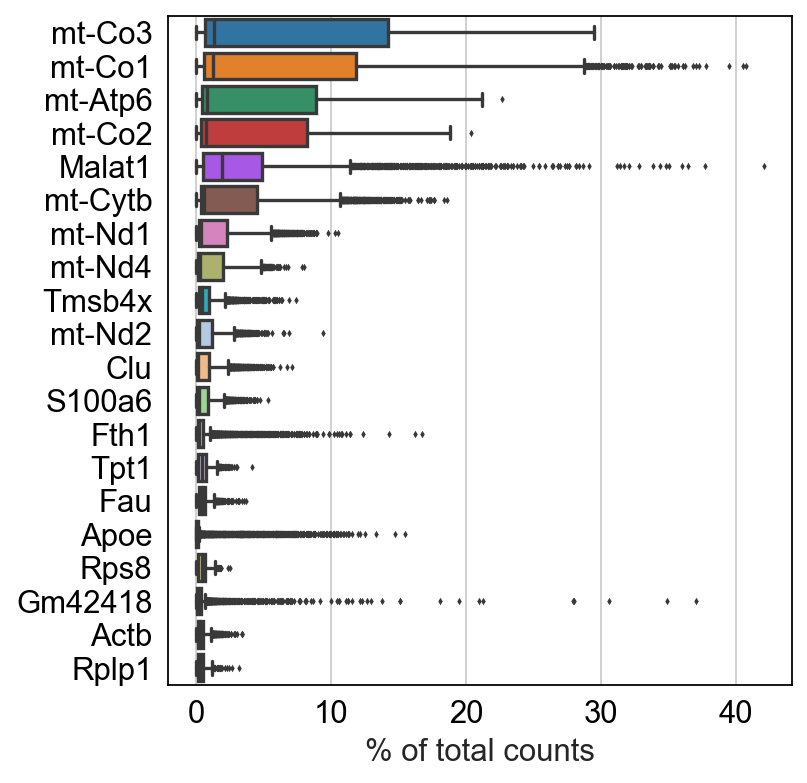

filtered out 881 cells that have less than 150 genes expressed
filtered out 12576 genes that are detected in less than 3 cells

After filter:

AnnData object with n_obs × n_vars = 8422 × 19709
    obs: 'n_batch', 'batch', 'n_genes'
    var: 'gene_ids', 'feature_types', 'n_cells'


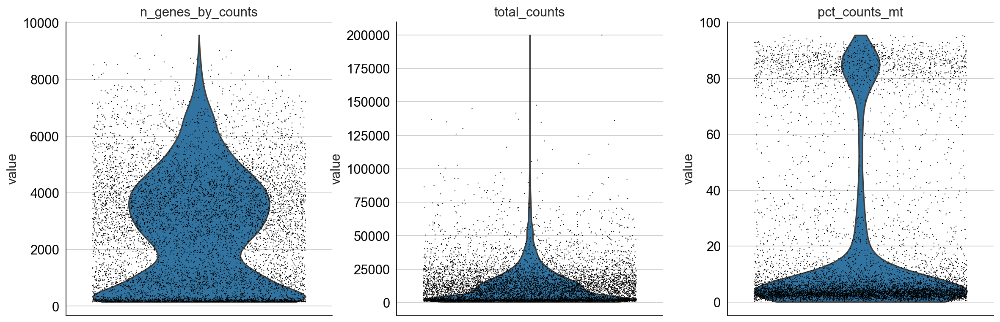

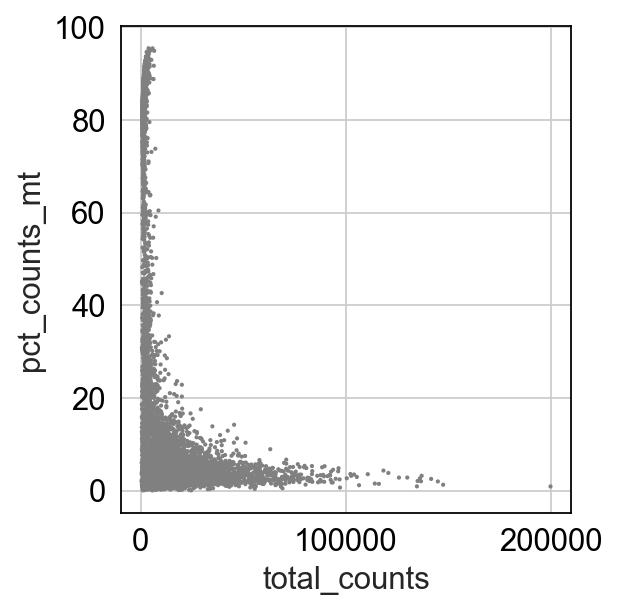

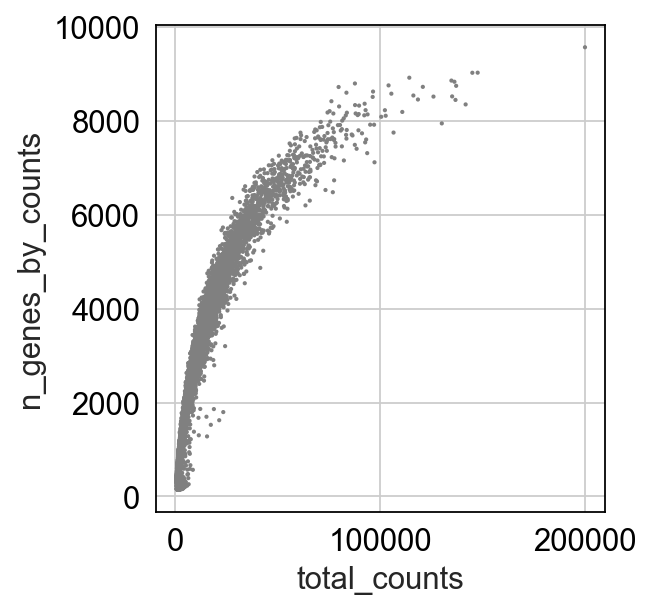

mt_initial_preprocess_and_plot shape


AnnData object with n_obs × n_vars = 8422 × 19709
    obs: 'n_batch', 'batch', 'n_genes', 'n_genes_by_counts', 'total_counts', 'total_counts_mt', 'pct_counts_mt'
    var: 'gene_ids', 'feature_types', 'n_cells', 'mt', 'n_cells_by_counts', 'mean_counts', 'pct_dropout_by_counts', 'total_counts'

preprocess shape


View of AnnData object with n_obs × n_vars = 6389 × 19709
    obs: 'n_batch', 'batch', 'n_genes', 'n_genes_by_counts', 'total_counts', 'total_counts_mt', 'pct_counts_mt'
    var: 'gene_ids', 'feature_types', 'n_cells', 'mt', 'n_cells_by_counts', 'mean_counts', 'pct_dropout_by_counts', 'total_counts'

normalizing counts per cell
    finished (0:00:00)
extracting highly variable genes
    finished (0:00:00)


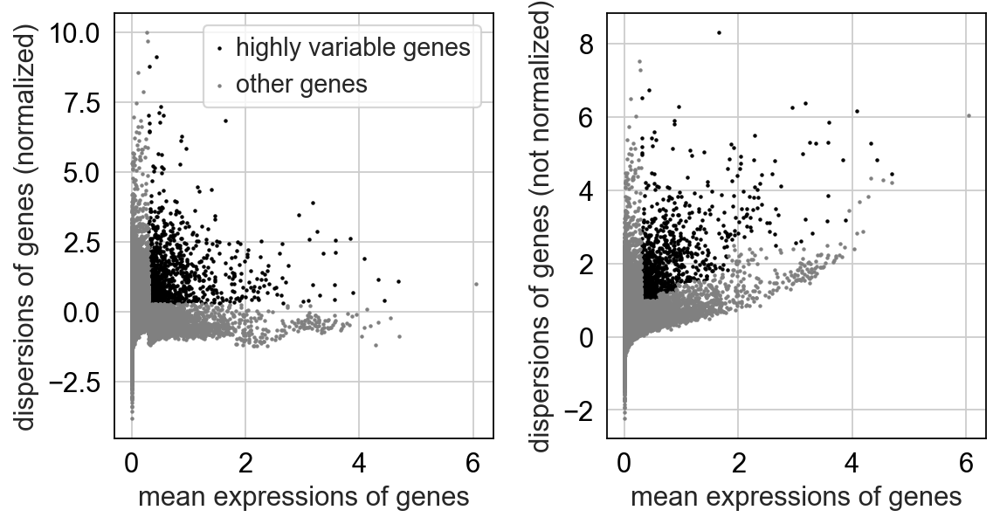

regressing out ['total_counts', 'pct_counts_mt']
    sparse input is densified and may lead to high memory use
    finished (0:00:06)
computing PCA
    on highly variable genes
    with n_comps=50
    finished (0:00:00)


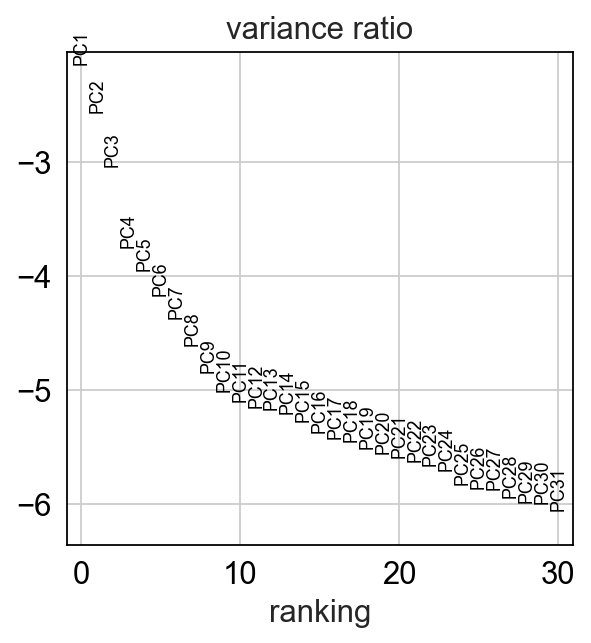

computing neighbors
    using 'X_pca' with n_pcs = 10
    finished (0:00:03)
running Louvain clustering
    using the "louvain" package of Traag (2017)
    finished (0:00:00)
running Leiden clustering
    finished (0:00:01)
computing tSNE
    using 'X_pca' with n_pcs = 50
    using sklearn.manifold.TSNE
    finished (0:00:23)


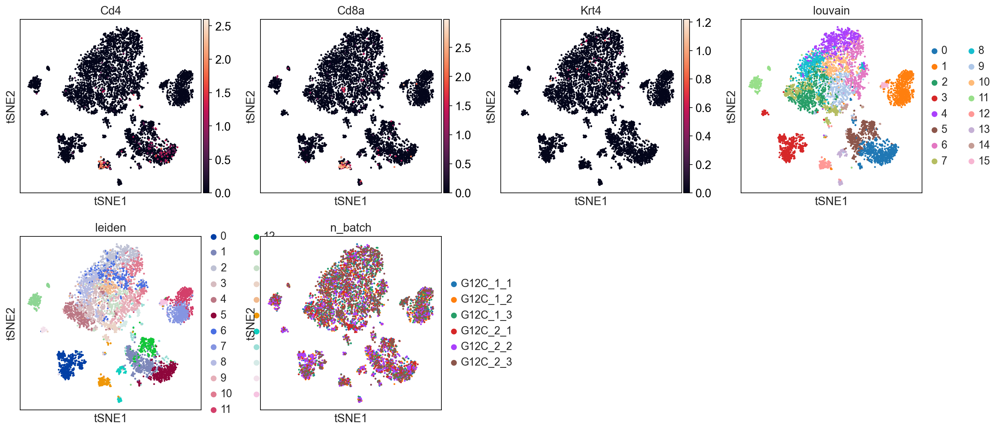

running PAGA
    finished (0:00:00)
computing UMAP
    finished (0:00:07)


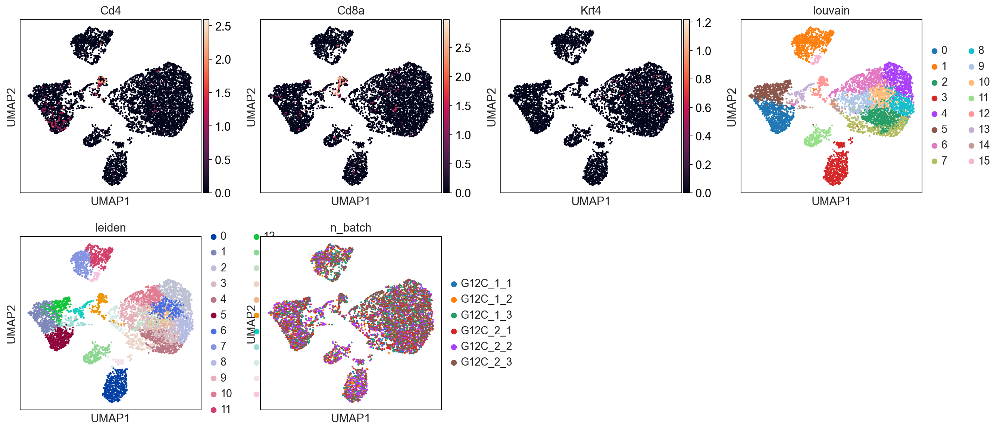

ranking genes
    finished (0:00:20)


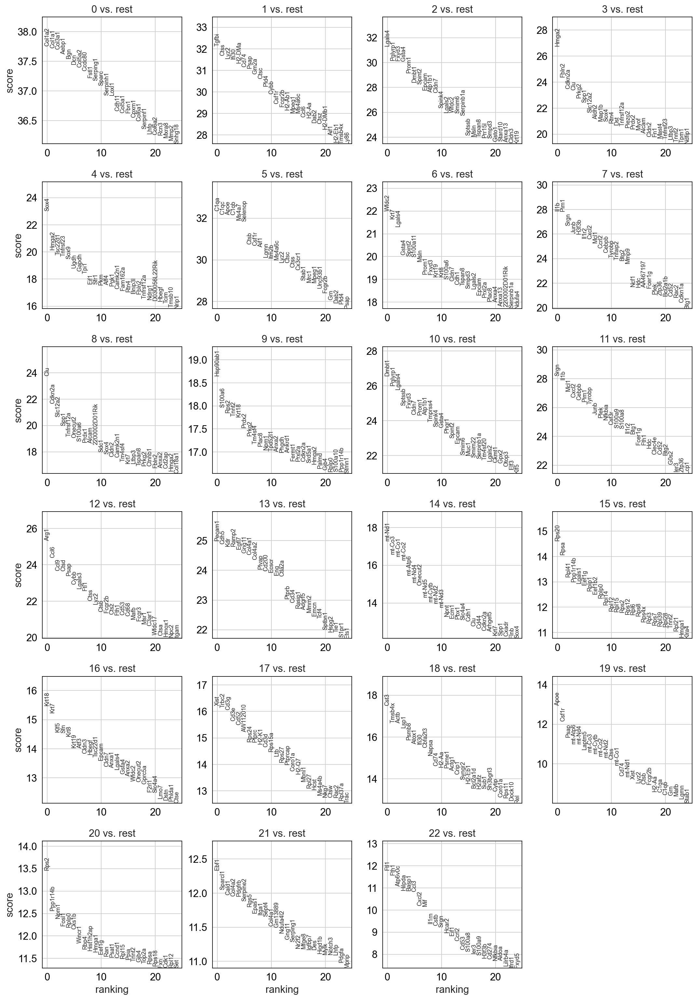

,0,1,2,3,4,5,6,7,8,9,10,11,12,13,14,15,16,17,18,19,20,21,22
0,Col1a2,Tgfbi,Lgals4,Hmga2,Sox4,C1qa,Wfdc2,Il1b,Clu,Hsp90ab1,Dmbt1,Srgn,Arg1,Pecam1,mt-Nd1,Rps20,Krt18,Xist,Cst3,Apoe,Rps2,Ebf1,Ftl1
1,Col1a1,Ctss,Pglyrp1,Fbln2,Hmga2,C1qc,Krt7,Pim1,Cdkn2a,S100a6,Pglyrp1,Il1b,Ccl6,Cdh5,mt-Co3,Rpsa,Krt7,Trbc2,Tmsb4x,Csf1r,Ppp1r14b,Sparcl1,Fth1
2,Col3a1,Lyz2,Fxyd3,Cdkn2a,Tsc22d1,Apoe,Lgals4,Srgn,Slc12a2,Rps2,Lgals4,Mcl1,Ccl9,Kdr,mt-Co1,Rpl41,Klf5,Cd3g,Actb,Psap,Npm1,Cald1,Atp6v0c
3,Aebp1,Ifi30,Gsta4,Clu,Tnfrsf23,C1qb,Gsta4,Junb,Spp1,Tnnt2,Sptssb,Cxcl2,Ctsd,Ramp2,mt-Co2,Ppp1r14b,Sfn,Cd3e,Lsp1,mt-Atp6,Fosl1,Col4a2,Hilpda
4,Bgn,H2-DMa,Prom1,Prkg2,Sox9,Ms4a7,Spint2,H3f3b,Tnfrsf12a,Krt18,Fxyd3,Cebpb,Psap,Egfl7,mt-Atp6,Lgals1,Krt8,Cd52,Psmb8,mt-Nd4,Rplp0,Pdgfrb,Basp1
5,Dcn,Cd74,Dmbt1,Spp1,Ugdh,Selenop,S100a11,Il1r2,Onecut2,Prdx2,Cldn7,Pim1,Cybb,Gng11,mt-Nd4,Eef1g,Krt19,AW112010,Atox1,Laptm5,Cks1b,Serpine2,Ccl3
6,Col5a2,Psap,Spint2,Slc12a2,Gapdh,Ctsb,Msln,Cxcl2,S100a6,Prkg2,Prom1,Tyrobp,Lgals3,Col4a1,Onecut2,Rplp1,Atf3,Rps24,Ifi30,mt-Co3,Wincr1,Rgs5,Cxcl2
7,Ccdc80,Gm2a,Epcam,Aldh2,Tpi1,Csf1r,Prom1,Mcl1,Prdx1,Tm4sf4,Atp1b1,Junb,Ftl1,Col4a2,mt-Nd5,Eef1b2,Cldn3,Ptprc,Cbfa2t3,mt-Cytb,Rbp4,Epas1,Mif
8,Fstl1,Ctsc,Atp1b1,Map1b,Eif1,Aif1,Fxyd3,Ccrl2,Alcam,Plac8,Tmprss4,Plek,Ctss,Plvap,mt-Cytb,Rplp0,Hbegf,H2-K1,Napsa,mt-Co2,Hist1h2ap,Itga1,Il1rn
9,Serping1,Pld4,Cldn7,Sox4,Sfr1,Lgmn,Krt19,Cebpb,2200002D01Rik,Npm1,Spink4,Nfkbia,Lyz2,Cd200,mt-Nd2,Rpl14,Tsc22d1,Cd3d,Cd74,mt-Nd2,Hmga1,Sept4,Cstb


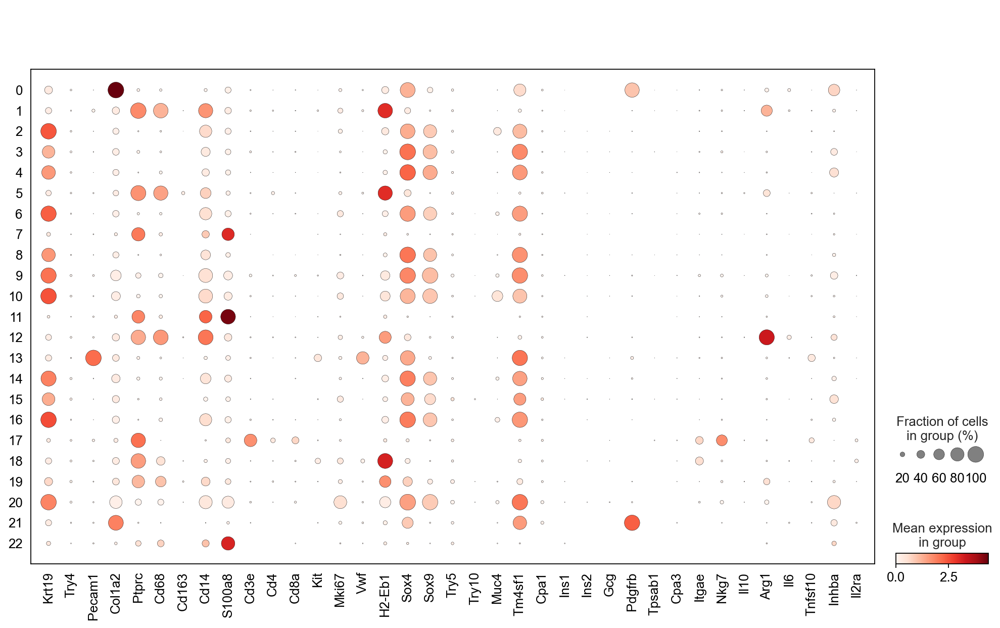

Running G12D
----------------------------------------------------------------------------

Reading from data/Mix1/G12D_1/sample_filtered_feature_bc_matrix/
... reading from cache file cache/data-Mix1-G12D_1-sample_filtered_feature_bc_matrix-matrix.h5ad
Reading from data/Mix1/G12D_2/sample_filtered_feature_bc_matrix/
... reading from cache file cache/data-Mix1-G12D_2-sample_filtered_feature_bc_matrix-matrix.h5ad
Reading from data/Mix1/G12D_3/sample_filtered_feature_bc_matrix/
... reading from cache file cache/data-Mix1-G12D_3-sample_filtered_feature_bc_matrix-matrix.h5ad
Reading from data/Mix2/G12D_1/sample_filtered_feature_bc_matrix/
... reading from cache file cache/data-Mix2-G12D_1-sample_filtered_feature_bc_matrix-matrix.h5ad
Reading from data/Mix2/G12D_2/sample_filtered_feature_bc_matrix/
... reading from cache file cache/data-Mix2-G12D_2-sample_filtered_feature_bc_matrix-matrix.h5ad
Reading from data/Mix2/G12D_3/sample_filtered_feature_bc_matrix/
... reading from cache file cache/

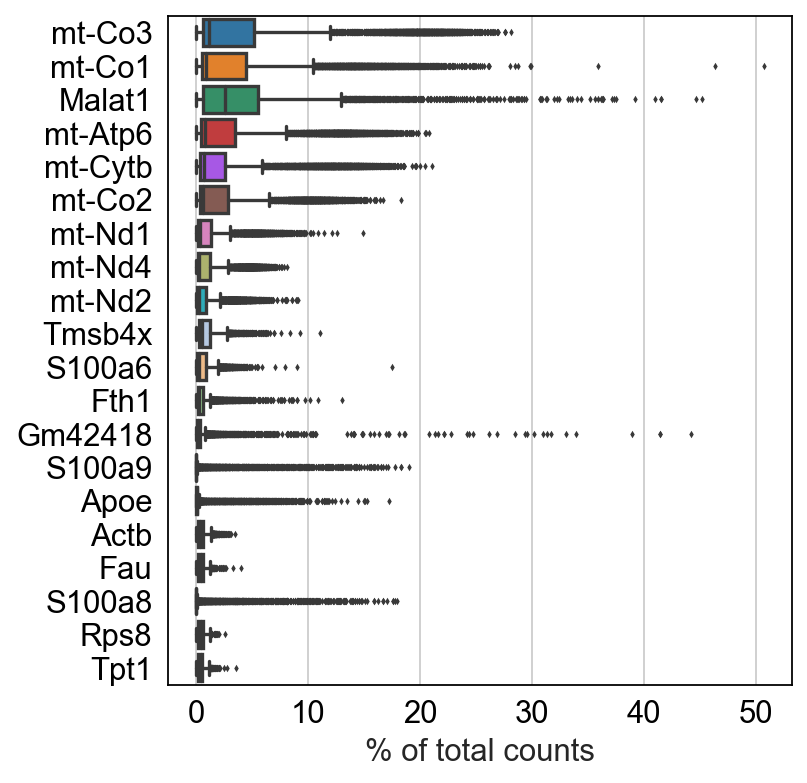

filtered out 709 cells that have less than 150 genes expressed
filtered out 12296 genes that are detected in less than 3 cells

After filter:

AnnData object with n_obs × n_vars = 9691 × 19989
    obs: 'n_batch', 'batch', 'n_genes'
    var: 'gene_ids', 'feature_types', 'n_cells'


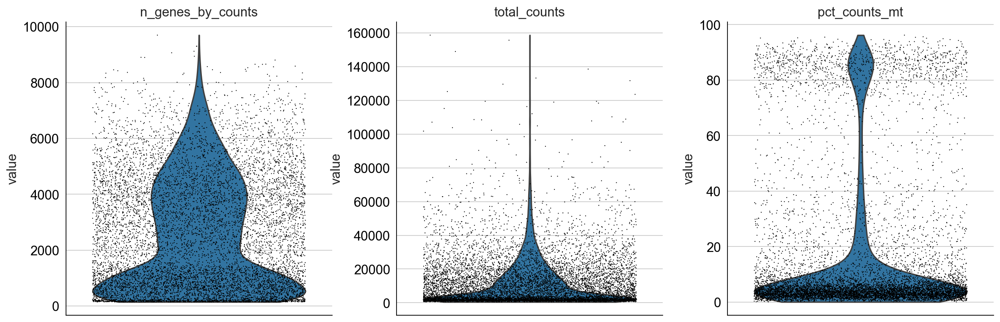

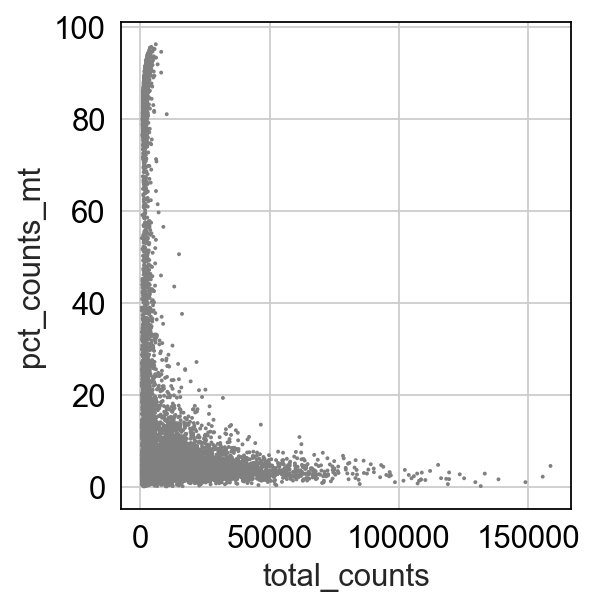

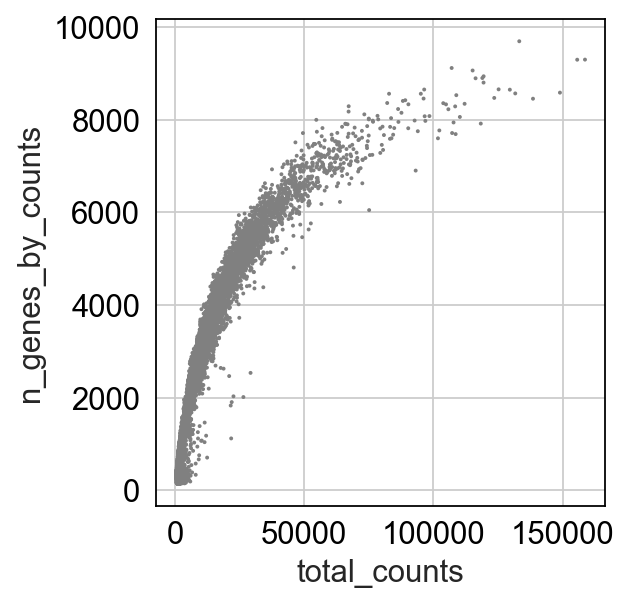

mt_initial_preprocess_and_plot shape


AnnData object with n_obs × n_vars = 9691 × 19989
    obs: 'n_batch', 'batch', 'n_genes', 'n_genes_by_counts', 'total_counts', 'total_counts_mt', 'pct_counts_mt'
    var: 'gene_ids', 'feature_types', 'n_cells', 'mt', 'n_cells_by_counts', 'mean_counts', 'pct_dropout_by_counts', 'total_counts'

preprocess shape


View of AnnData object with n_obs × n_vars = 7694 × 19989
    obs: 'n_batch', 'batch', 'n_genes', 'n_genes_by_counts', 'total_counts', 'total_counts_mt', 'pct_counts_mt'
    var: 'gene_ids', 'feature_types', 'n_cells', 'mt', 'n_cells_by_counts', 'mean_counts', 'pct_dropout_by_counts', 'total_counts'

normalizing counts per cell
    finished (0:00:00)
extracting highly variable genes
    finished (0:00:00)


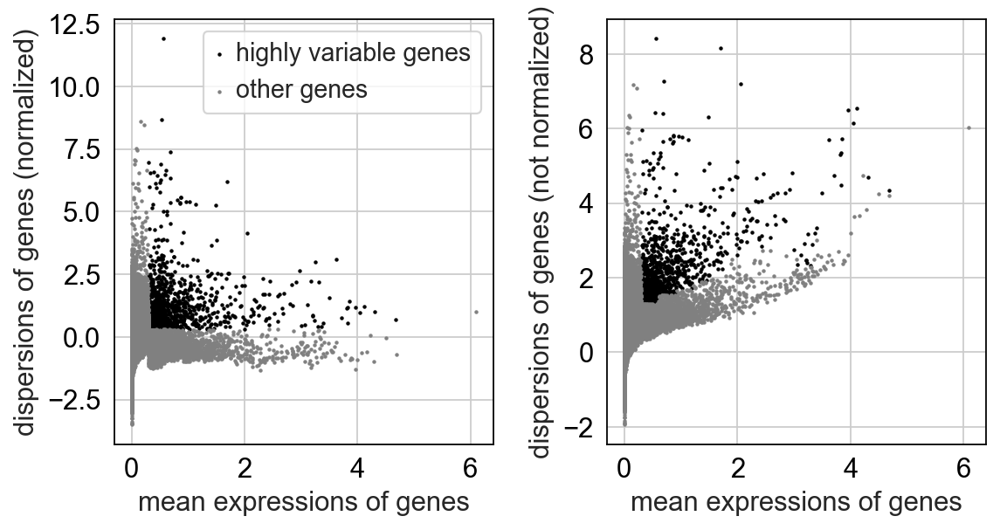

regressing out ['total_counts', 'pct_counts_mt']
    sparse input is densified and may lead to high memory use
    finished (0:00:06)
computing PCA
    on highly variable genes
    with n_comps=50
    finished (0:00:00)


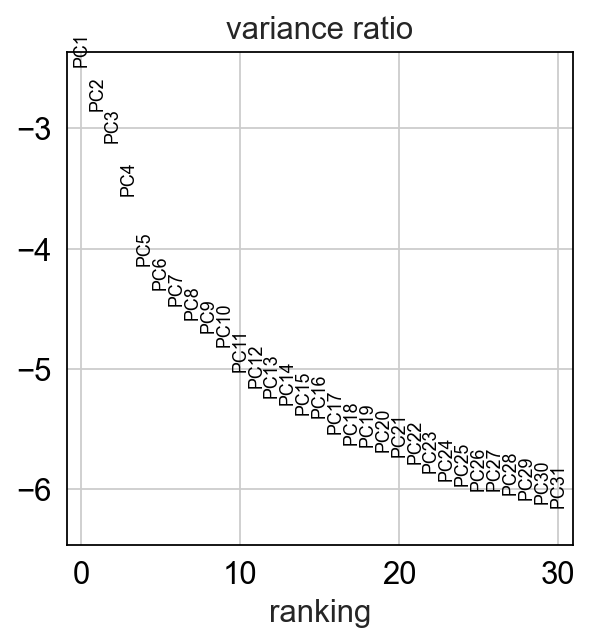

computing neighbors
    using 'X_pca' with n_pcs = 10
    finished (0:00:01)
running Louvain clustering
    using the "louvain" package of Traag (2017)
    finished (0:00:00)
running Leiden clustering
    finished (0:00:03)
computing tSNE
    using 'X_pca' with n_pcs = 50
    using sklearn.manifold.TSNE
    finished (0:00:31)


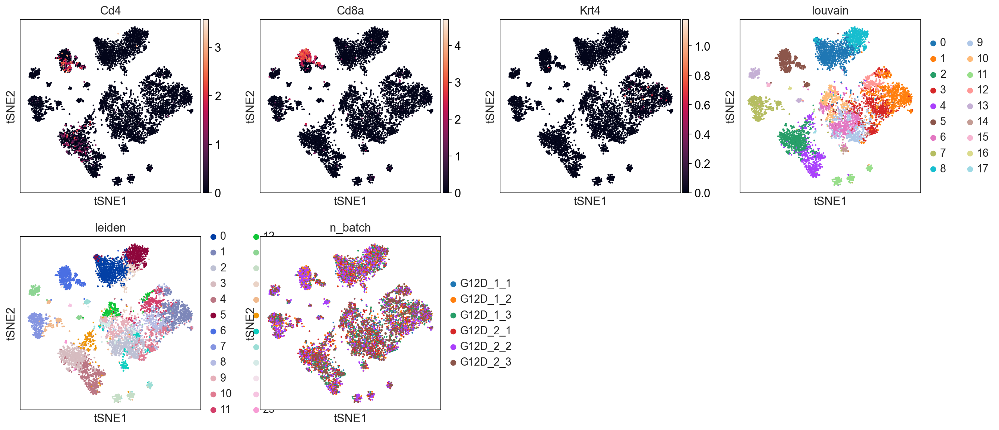

running PAGA
    finished (0:00:00)
computing UMAP
    finished (0:00:08)


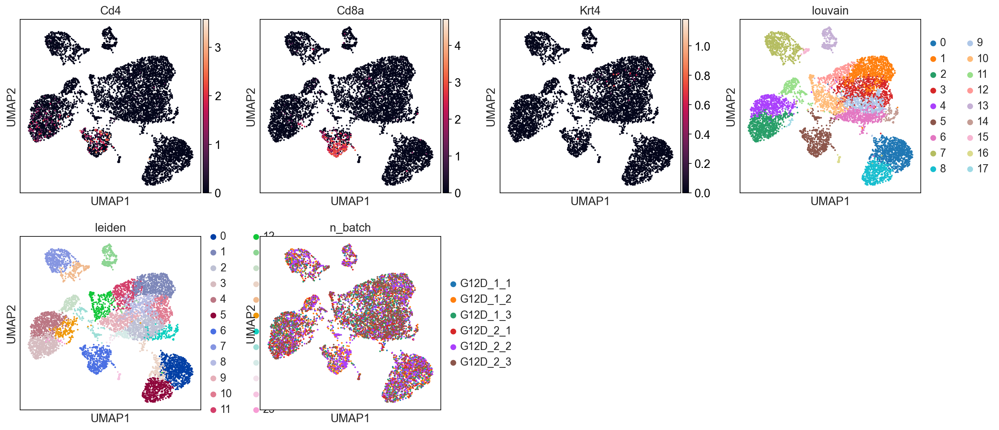

ranking genes
    finished (0:00:26)


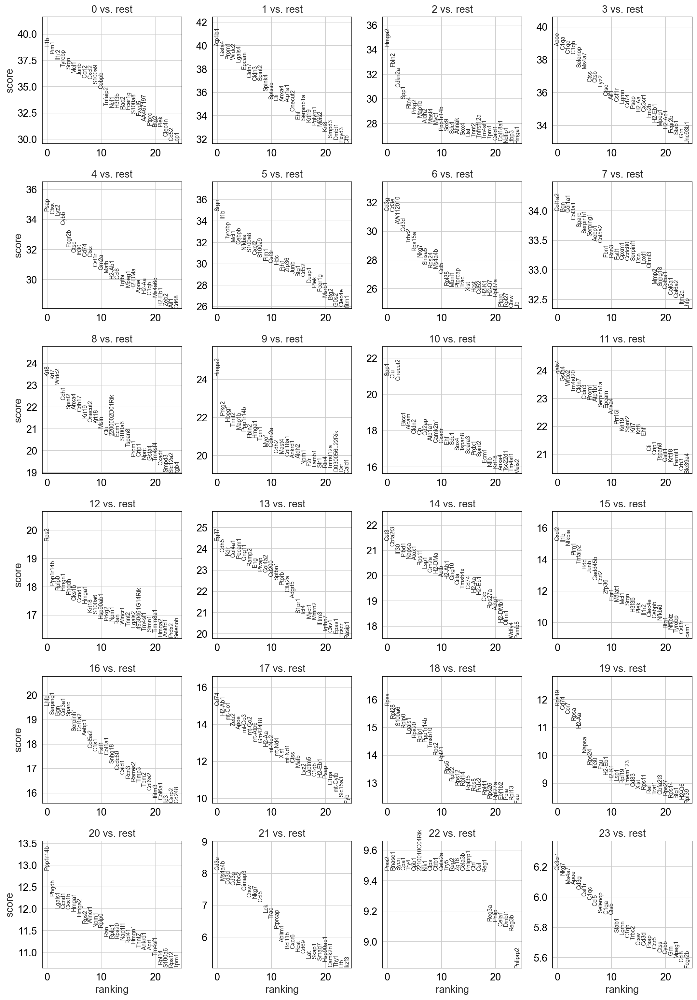

,0,1,2,3,4,5,6,7,8,9,10,11,12,13,14,15,16,17,18,19,20,21,22,23
0,Il1b,Atp1b1,Hmga2,Apoe,Psap,Srgn,Cd3g,Col1a2,Krt8,Hmga2,Spp1,Lgals4,Rps2,Egfl7,Cst3,Cxcl2,Lhfp,Cd74,Rpsa,Rps19,Ppp1r14b,Cd3e,Prss2,Cx3cr1
1,Pim1,Gsta4,Fbln2,C1qa,Ctss,Il1b,Cd3e,Bgn,Krt7,Prkg2,Clu,Gsta4,Ppp1r14b,Cdh5,Cbfa2t3,Il1b,Serping1,H2-Ab1,Rpl28,Cd74,Phgdh,Ms4a4b,Rnase1,Nkg7
2,Il1r2,Prom1,Cdkn2a,C1qc,Lyz2,Tyrobp,AW112010,Col1a1,Wfdc2,Hbegf,Onecut2,Wfdc2,Rplp0,Kdr,Ifi30,Nfkbia,Bgn,mt-Co1,S100a6,Ccr7,Lgals1,Cd3d,Sycn,Ms4a7
3,Tyrobp,Wfdc2,Spp1,C1qb,Cybb,Mcl1,Cd3d,Col3a1,Cdh1,Tnnt2,Bicc1,Tm4sf20,Hmgn1,Col4a1,Plbd1,Pim1,Col3a1,Zeb2,Rplp0,Rpsa,Ccnd1,Cd3g,Cpa1,Apoe
4,Srgn,Lgals4,Rtn4,Selenop,Fcgr2b,Cebpb,Trbc2,Sparc,Spint2,Map1b,Alcam,Cldn7,Phgdh,Pecam1,Napsa,Tnfaip2,Sparc,Apoe,Lgals1,H2-Aa,Cks1b,Trbc2,Try4,Cd3g
5,Mcl1,Epcam,Prkg2,Ms4a7,Ctsc,Nfkbia,Rps15a,Serpinh1,Anxa4,Ppp1r14b,Cldn2,Cldn3,Cks1b,Gng11,Atox1,Hdc,Serpinh1,mt-Co3,Rps20,Napsa,Hmga1,Gimap3,Cpb1,Csf1r
6,Junb,Cldn7,Map1b,Ctss,Ifi30,S100a8,Nkg7,Serping1,Cdh17,Fbln2,Cp,Prom1,Ccnd1,Ramp2,Rps11,Junb,Col1a2,mt-Co2,Rplp1,Rps24,Hmga2,Ctsw,2210010C04Rik,C1qc
7,Ccrl2,Cldn3,Aldh2,Ctsb,Cd74,Cxcl2,Shisa5,Aebp1,Krt19,Hmga1,Cd2ap,Atp1b1,Hmga1,Eng,Lsp1,Gadd45b,Aebp1,mt-Atp6,Ppp1r14b,Ifi30,Rps2,Nkg7,Klk1,Ccl5
8,Cxcl2,Spint2,Mast4,Lyz2,Ctsz,S100a9,Rps24,Col5a2,Onecut2,Tpm1,Atp1a1,Serpinb1a,Krt18,Plvap,Gm2a,Ccrl2,Col5a2,Gm42418,Tmsb10,Fau,Wincr1,Ccl5,Clps,Selenop
9,S100a9,Spink4,Myof,Ctsc,Csf1r,Pim1,Ms4a4b,Fbn1,Krt18,Myof,Camk2n1,Epcam,S100a6,Col4a2,H2-DMa,Zfp36,C1s1,H2-Aa,Rps2,H2-Eb1,Npm1,Lck,Ctrb1,C1qa


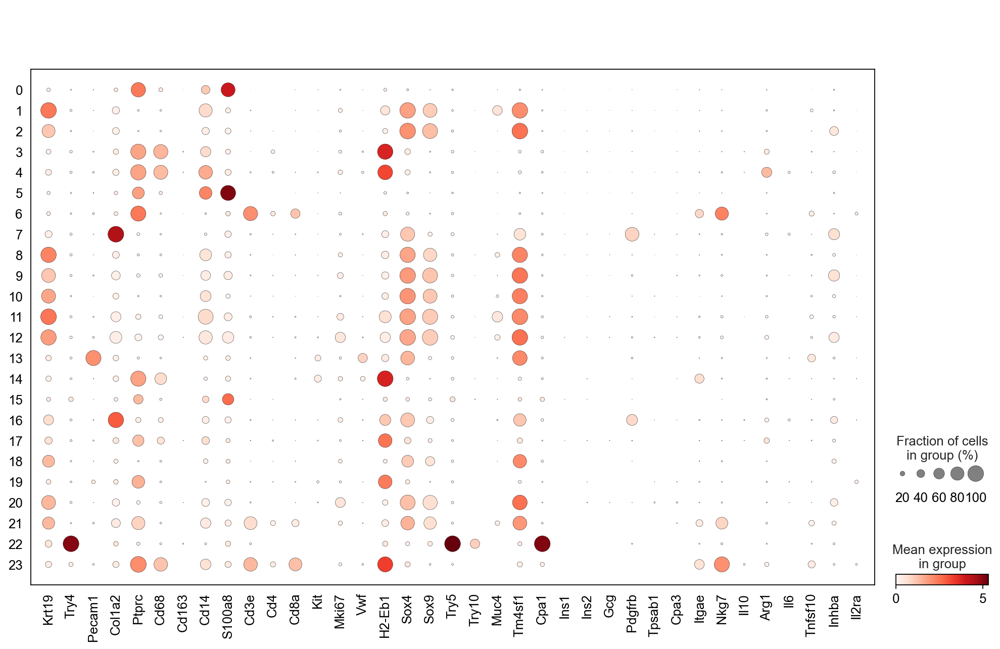

Running G12R
----------------------------------------------------------------------------

Reading from data/raw-selected/KrasG12R_1/sample_filtered_feature_bc_matrix
... reading from cache file cache/data-raw-selected-KrasG12R_1-sample_filtered_feature_bc_matrix-matrix.h5ad
Reading from data/raw-selected/KrasG12R_2/sample_filtered_feature_bc_matrix
... reading from cache file cache/data-raw-selected-KrasG12R_2-sample_filtered_feature_bc_matrix-matrix.h5ad
Reading from data/raw-selected/KrasG12R_3/sample_filtered_feature_bc_matrix
... reading from cache file cache/data-raw-selected-KrasG12R_3-sample_filtered_feature_bc_matrix-matrix.h5ad
AnnData object with n_obs × n_vars = 3861 × 32285
    obs: 'n_batch', 'batch'
    var: 'gene_ids', 'feature_types'
normalizing counts per cell
    finished (0:00:00)


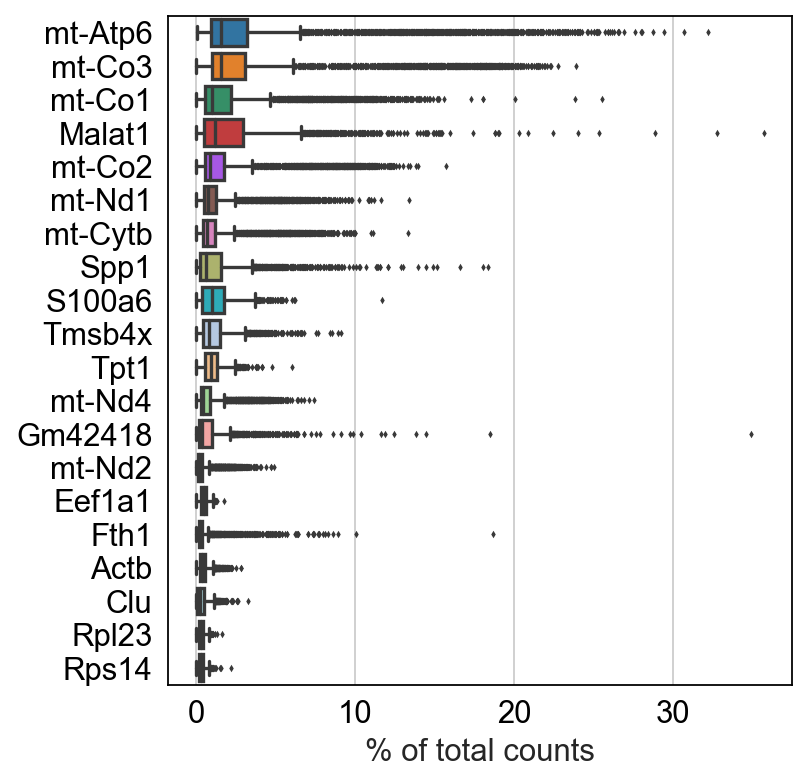

filtered out 7 cells that have less than 150 genes expressed
filtered out 14305 genes that are detected in less than 3 cells

After filter:

AnnData object with n_obs × n_vars = 3854 × 17980
    obs: 'n_batch', 'batch', 'n_genes'
    var: 'gene_ids', 'feature_types', 'n_cells'


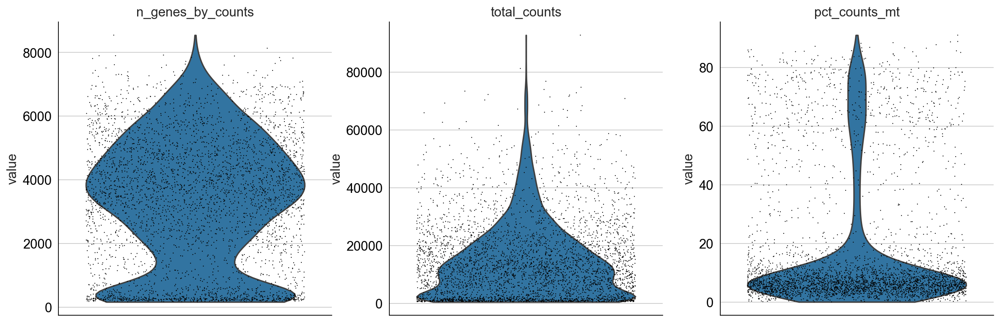

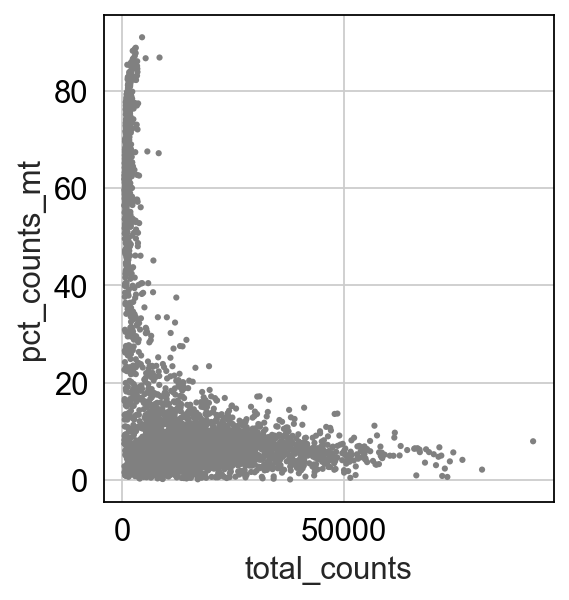

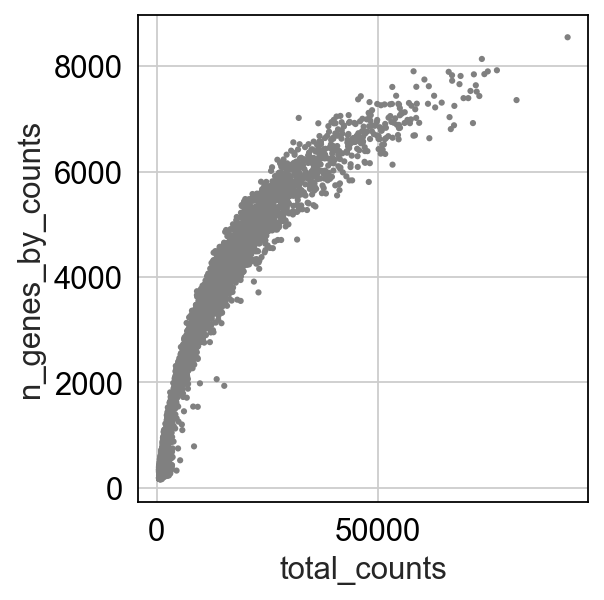

mt_initial_preprocess_and_plot shape


AnnData object with n_obs × n_vars = 3854 × 17980
    obs: 'n_batch', 'batch', 'n_genes', 'n_genes_by_counts', 'total_counts', 'total_counts_mt', 'pct_counts_mt'
    var: 'gene_ids', 'feature_types', 'n_cells', 'mt', 'n_cells_by_counts', 'mean_counts', 'pct_dropout_by_counts', 'total_counts'

preprocess shape


View of AnnData object with n_obs × n_vars = 3070 × 17980
    obs: 'n_batch', 'batch', 'n_genes', 'n_genes_by_counts', 'total_counts', 'total_counts_mt', 'pct_counts_mt'
    var: 'gene_ids', 'feature_types', 'n_cells', 'mt', 'n_cells_by_counts', 'mean_counts', 'pct_dropout_by_counts', 'total_counts'

normalizing counts per cell
    finished (0:00:00)
extracting highly variable genes
    finished (0:00:00)


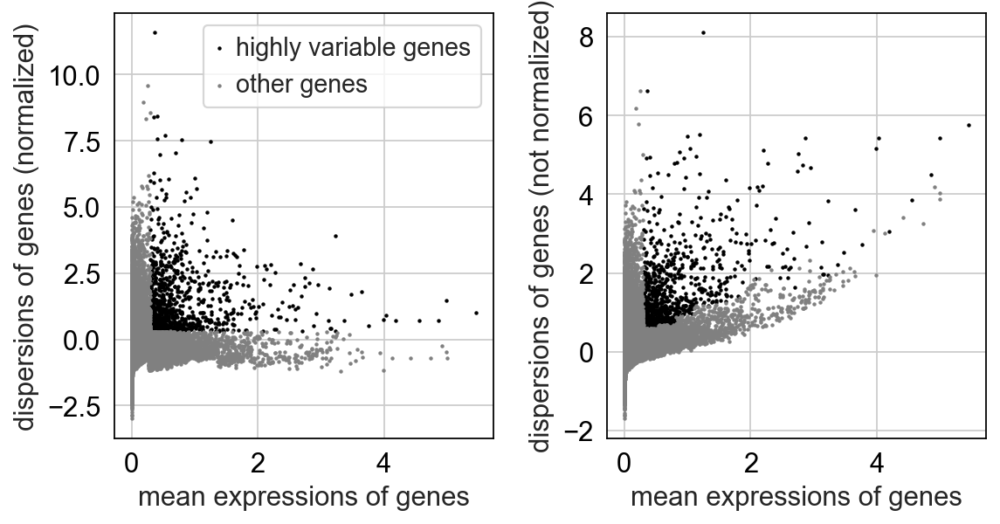

regressing out ['total_counts', 'pct_counts_mt']
    sparse input is densified and may lead to high memory use
    finished (0:00:03)
computing PCA
    on highly variable genes
    with n_comps=50
    finished (0:00:00)


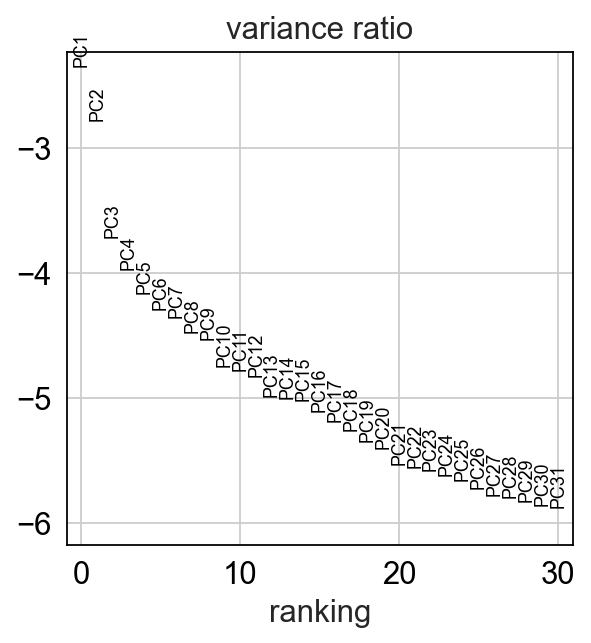

computing neighbors
    using 'X_pca' with n_pcs = 10
    finished (0:00:00)
running Louvain clustering
    using the "louvain" package of Traag (2017)
    finished (0:00:00)
running Leiden clustering
    finished (0:00:00)
computing tSNE
    using 'X_pca' with n_pcs = 50
    using sklearn.manifold.TSNE
    finished (0:00:09)


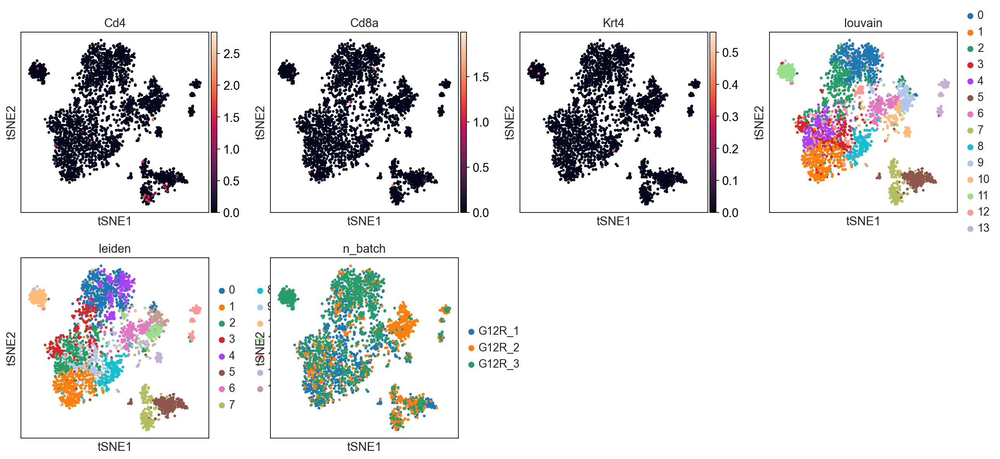

running PAGA
    finished (0:00:00)
computing UMAP
    finished (0:00:03)


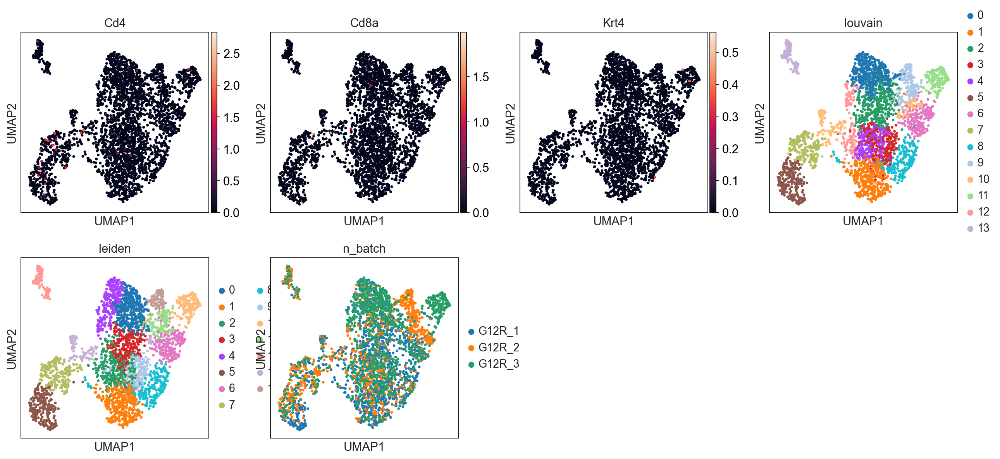

ranking genes
    finished (0:00:08)


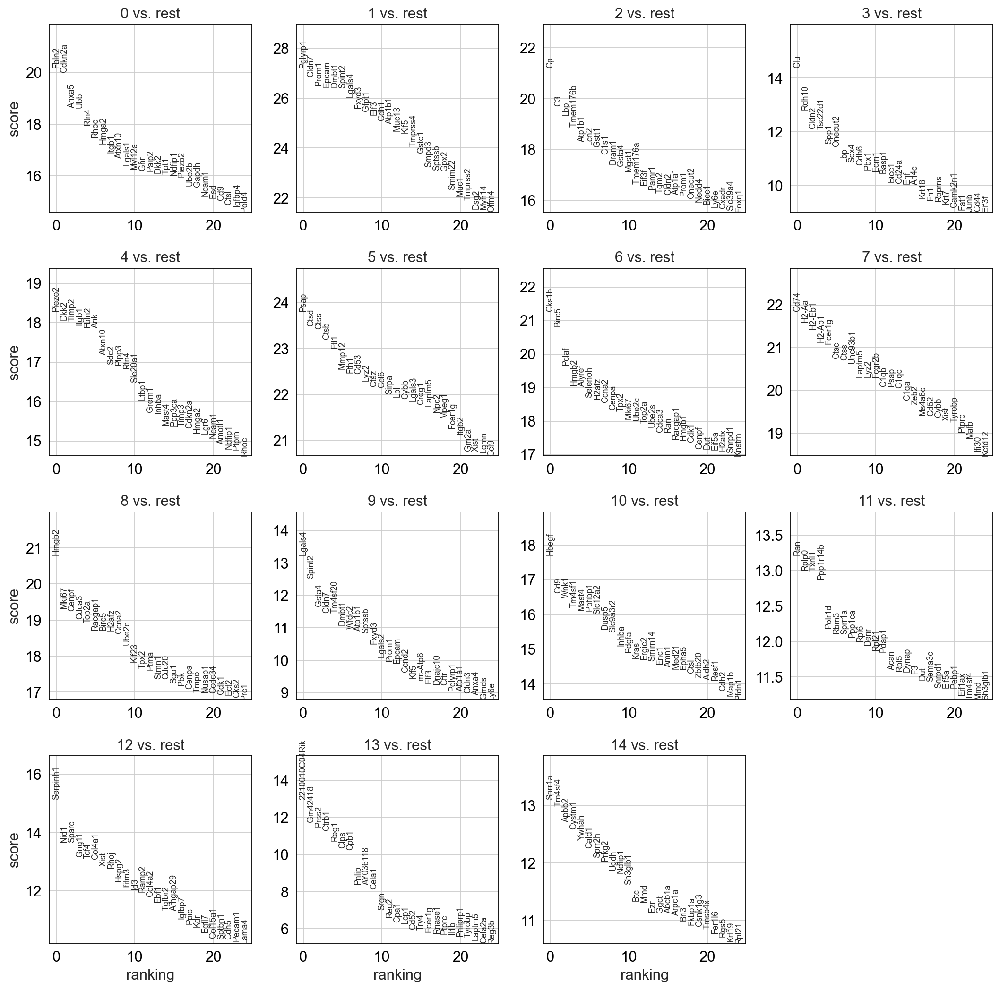

,0,1,2,3,4,5,6,7,8,9,10,11,12,13,14
0,Fbln2,Pglyrp1,Cp,Clu,Piezo2,Psap,Cks1b,Cd74,Hmgb2,Lgals4,Hbegf,Ran,Serpinh1,2210010C04Rik,Sprr1a
1,Cdkn2a,Cldn7,C3,Rdh10,Dkk2,Ctsd,Birc5,H2-Aa,Mki67,Spint2,Cd9,Rplp0,Nid1,Gm42418,Tm4sf4
2,Anxa5,Prom1,Lbp,Cldn2,Timp2,Ctss,Pclaf,H2-Eb1,Cenpf,Gsta4,Wnk1,Txnl1,Sparc,Prss2,Apbb2
3,Ubb,Epcam,Tmem176b,Tsc22d1,Itgb1,Ctsb,Hmgb2,H2-Ab1,Cdca3,Cldn7,Tm4sf1,Ppp1r14b,Gng11,Ctrb1,Cystm1
4,Rtn4,Dmbt1,Atp1b1,Spp1,Fbln2,Ftl1,Alyref,Fcer1g,Top2a,Tm4sf20,Mast4,Polr1d,Tcf4,Reg1,Ywhah
5,Rhoc,Spint2,Lcn2,Onecut2,Ank,Mmp12,Selenoh,Ctsc,Racgap1,Dmbt1,Ppfibp1,Rbm3,Col4a1,Clps,Cald1
6,Hmga2,Lgals4,Gstt1,Lbp,Atxn10,Fth1,H2afz,Ctss,Birc5,Wfdc2,Slc12a2,Sprr1a,Xist,Cpb1,Sprr2h
7,Itgb1,Fxyd3,C1s1,Sox4,Sdc2,Cd53,Ccna2,Unc93b1,H2afz,Atp1b1,Dusp5,Ppp1ca,Rhoj,Pnlip,Prkg2
8,Atxn10,Gfpt1,Dram1,Cdh6,Plpp3,Lyz2,Cenpa,Laptm5,Ccna2,Sptssb,Slc9a3r2,Rpl6,Hspg2,AY036118,Ugdh
9,Lgals1,Elf3,Gsta4,Pbx1,Rtn4,Ctsz,Tpx2,Lyz2,Ube2c,Fxyd3,Inhba,Denr,Ifitm3,Cela1,Ndfip1


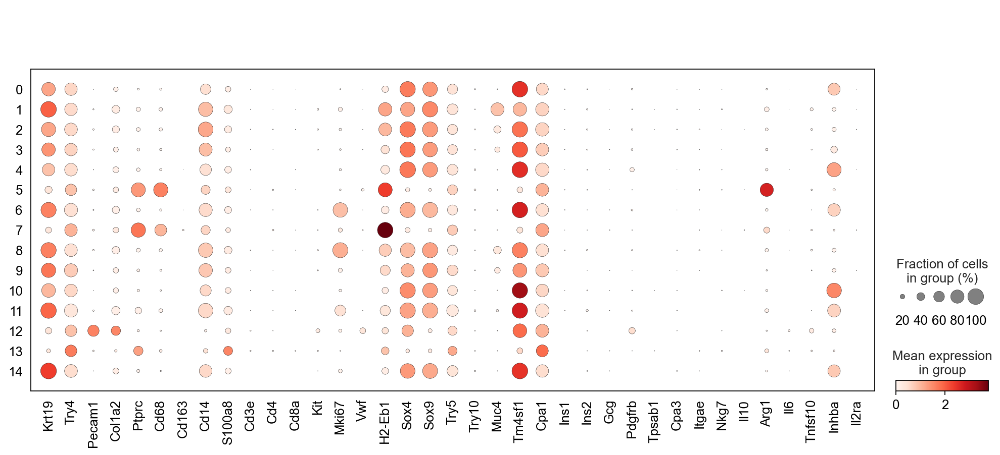

In [5]:
results_map = {}

for cond in conditions:
    print(f'Running {cond}\n----------------------------------------------------------------------------\n')
    if cond != 'G12R':
        adata = read_data('first', condition=cond, replicate_num=None)
    else:
        adata = read_data('second', replicate_num=None)
        
    adata = mt_initial_preprocess_and_plot(adata)
    adata = preprocess(adata, min_mean=0.3, min_disp=0.3)
    adata = neighborhood_graph_and_clustering(adata, color=['Cd4', 'Cd8a', 'Krt4', 'louvain', 'leiden','n_batch'], 
                                              n_pcs=10, use_raw=True, perplexity=30)
    adata, top_genes_df = markers(adata)

    display(top_genes_df)

    sc.pl.dotplot(adata, marker_genes, groupby='leiden')
    
    results_map[cond] = {}
    results_map[cond]['adata'] = adata
    results_map[cond]['top_genes_df'] = top_genes_df

## Clusters mapping by marker genes

In [6]:
G12C_clusters = {
    0: 'Fibroblasts',
    1: 'Macrophages M1 (Immune)', 
    2: 'Cancer',
    3: 'Cancer',
    4: 'Cancer',
    5: 'Macrophages M2 (Immune)',
    6: 'Cancer',
    7: 'B cells (Immune)',
    8: 'Cancer',
    9: 'Cancer',
    10: 'Cancer',
    11: 'MDSCs (Immune)',
    12: 'Macrophages M2 (Immune)',
    13: 'Endothelial', 
    14: 'Cancer',
    15: 'Cancer',
    16: 'Cancer',
    17: 'T cells  (Immune)',
    18: 'Dendritic cells (Immune)',
    19: 'B cells (Immune)',
    20: 'Cancer', 
    21: 'Fibroblasts (stellate)',
    22: 'MDSCs (Immune)'
}


G12D_clusters = {
    0: 'MDSCs (Immune)',
    1: 'Cancer',
    2: 'Cancer',
    3: 'Macrophages M2 (Immune)',
    4: 'Macrophages M2 (Immune)',
    5: 'Immune',
    6: 'MDSCs (Immune)',
    7: 'T cells (Immune)',
    8: 'Cancer',
    9: 'Cancer', 
    10: 'Cancer',
    11: 'Cancer',
    12: 'Cancer',
    13: 'Endothelial',
    14: 'MDSCs (Immune)',
    15: 'Immune',
    16: 'Immune',
    17: 'Dendritic cells (Immune)',
    18: 'Cancer',
    19: 'Immune',
    20: 'Immune',
    21: 'Cancer',
    22: 'Acinar',
    23: 'Immune'
}

G12R_clusters = {
    0: 'Immune (prob. M2 macrophages)',
    1: 'Cancer',
    2: 'Cancer',
    3: 'Cancer',
    4: 'Immune (prob. M1 macrophages)',
    5: 'immune (prob. M1 macrophages and B-cells)',
    6: 'Cancer',
    7: 'Immune',
    8: 'Cancer',
    9: 'Cancer',
    10: 'Immune',
    11: 'Immune',
    12: 'Immune (Fibroblasts/Endothelial/stellate - I see 3 subclusters in the tsne so makes sense)',
    13: 'Acinar',
    14: 'Immune'
}

In [7]:
G12C = results_map['G12C']['adata'].copy()
G12D = results_map['G12D']['adata'].copy()
G12R = results_map['G12R']['adata'].copy()

## TSNE with new cluster annotations and filtered for immune cells

G12C


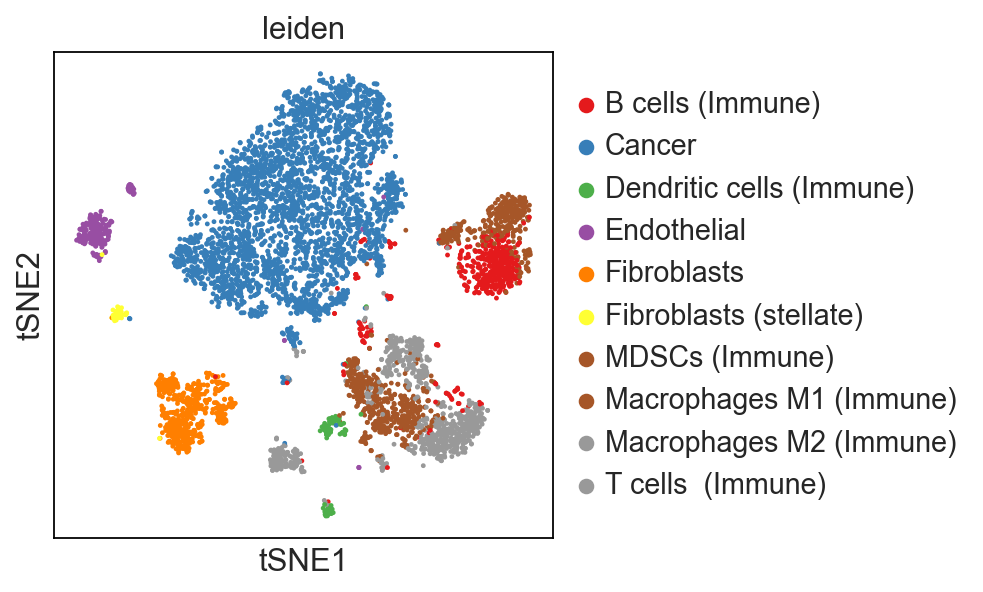

running Leiden clustering
    finished (0:00:00)
computing tSNE
    using 'X_pca' with n_pcs = 50
    using sklearn.manifold.TSNE
    finished (0:00:07)


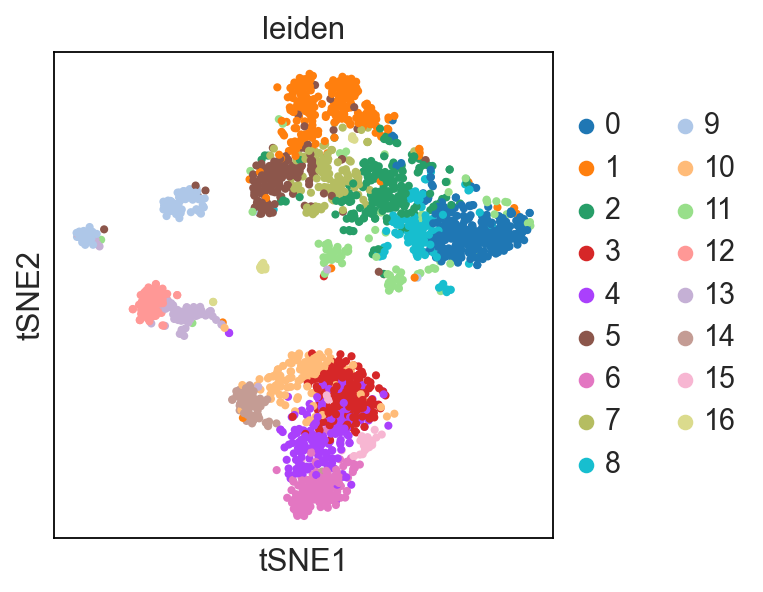

ranking genes
    finished (0:00:06)


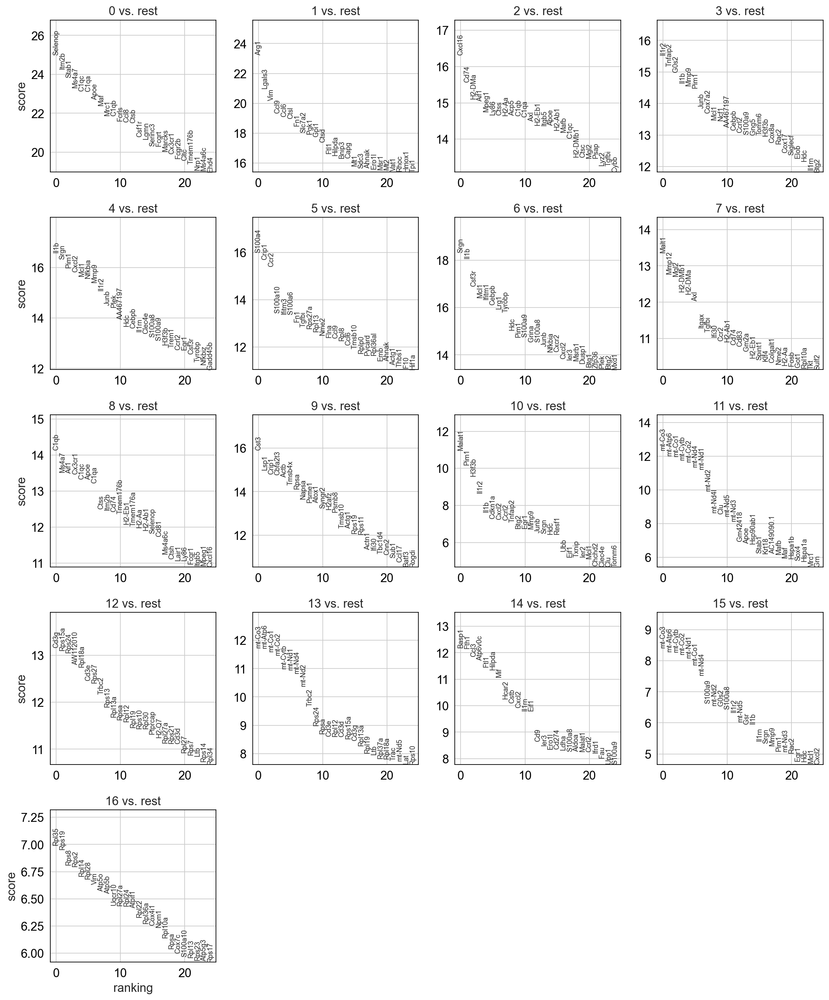

,0,1,2,3,4,5,6,7,8,9,10,11,12,13,14,15,16
0,Selenop,Arg1,Cxcl16,Il1r2,Il1b,S100a4,Srgn,Malt1,C1qb,Cst3,Malat1,mt-Co3,Cd3g,mt-Co3,Basp1,mt-Co3,Rpl35
1,Itm2b,Lgals3,Cd74,Tnfaip2,Srgn,Crip1,Il1b,Mmp12,Ms4a7,Lsp1,Pim1,mt-Atp6,Rps15a,mt-Atp6,Fth1,mt-Atp6,Rps19
2,Stab1,Vim,H2-DMa,G0s2,Pim1,Ccr2,Csf3r,Mgl2,Aif1,Crip1,H3f3b,mt-Co1,Rps24,mt-Co1,Ccl3,mt-Cytb,Rps8
3,Ms4a7,Ccl9,Aif1,Il1b,Cxcl2,S100a10,Mcl1,H2-DMb1,Cx3cr1,Cbfa2t3,Il1r2,mt-Cytb,AW112010,mt-Co2,Atp6v0c,mt-Co2,Rps2
4,C1qc,Ccl6,Mpeg1,Mmp9,Mcl1,Ifitm3,Ifitm1,H2-DMa,C1qc,Actb,Il1b,mt-Co2,Rpl18a,mt-Cytb,Ftl1,mt-Nd1,Rpl14
5,C1qa,Ctsl,Ly86,Pim1,Nfkbia,S100a6,Cebpb,Axl,Apoe,Tmsb4x,Cdkn1a,mt-Nd4,Cd3e,mt-Nd1,Hilpda,mt-Co1,Rpl28
6,Apoe,Fn1,Ctss,Junb,Mmp9,Fn1,Lrg1,Itgax,C1qa,Rpsa,Cxcl2,mt-Nd1,Rps27,mt-Nd4,Mif,mt-Nd4,Vim
7,Maf,Slc7a2,H2-Aa,Cox7a2,Il1r2,Tgfbi,Tyrobp,Tgfbi,Ctss,Napsa,Ccrl2,mt-Nd2,Trbc2,mt-Nd2,Hcar2,S100a9,Atp5o
8,Mrc1,Pgk1,Acp5,Mcl1,Junb,Rps27a,Hdc,Ifi30,Itm2b,Psme1,Tnfaip2,mt-Nd4l,Rps13,Trbc2,Cstb,mt-Nd2,Atp5b
9,C1qb,Gpi1,C1qb,Ncf1,Plek,Rpl13,Pim1,Ccr2,Cd74,Atox1,Btg2,Clu,Rpl13a,Rps24,Cxcl2,G0s2,Uqcr10


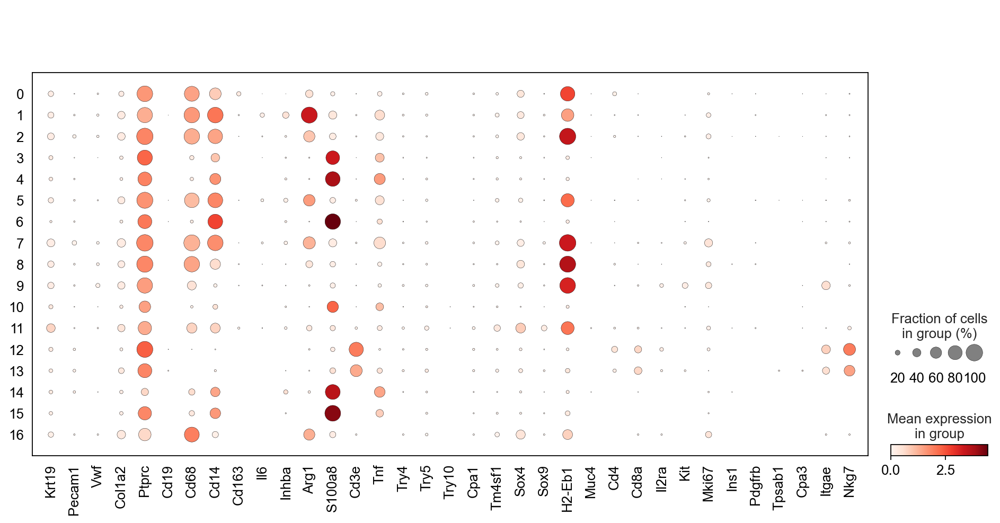

G12D


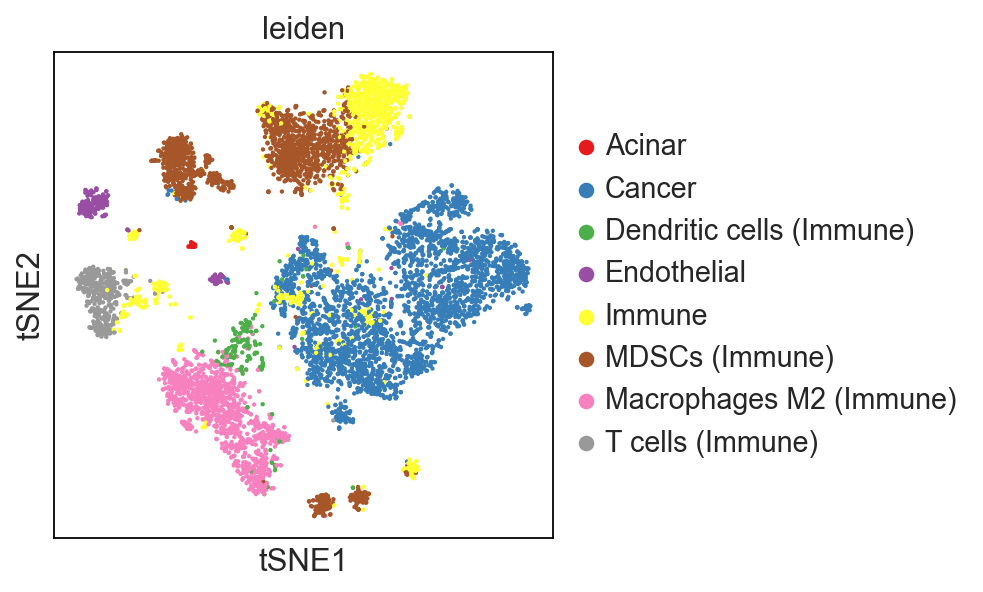

running Leiden clustering
    finished (0:00:01)
computing tSNE
    using 'X_pca' with n_pcs = 50
    using sklearn.manifold.TSNE
    finished (0:00:15)


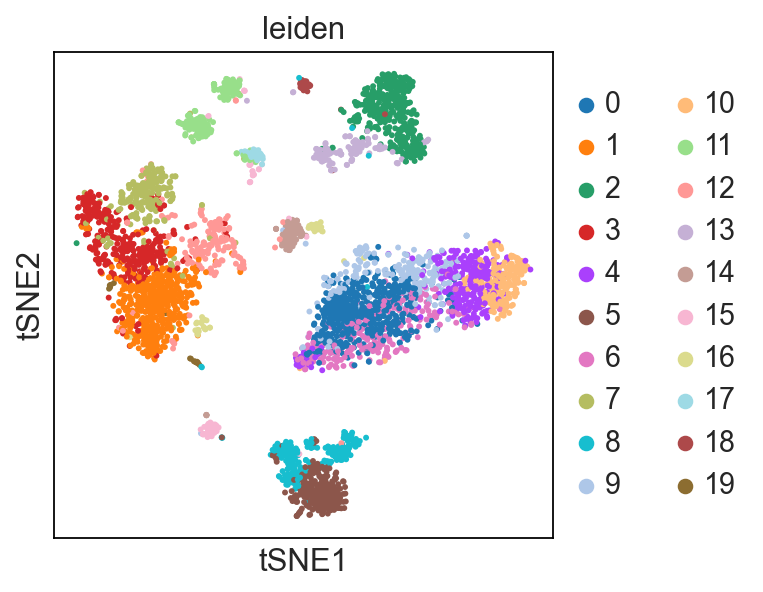

ranking genes
    finished (0:00:11)


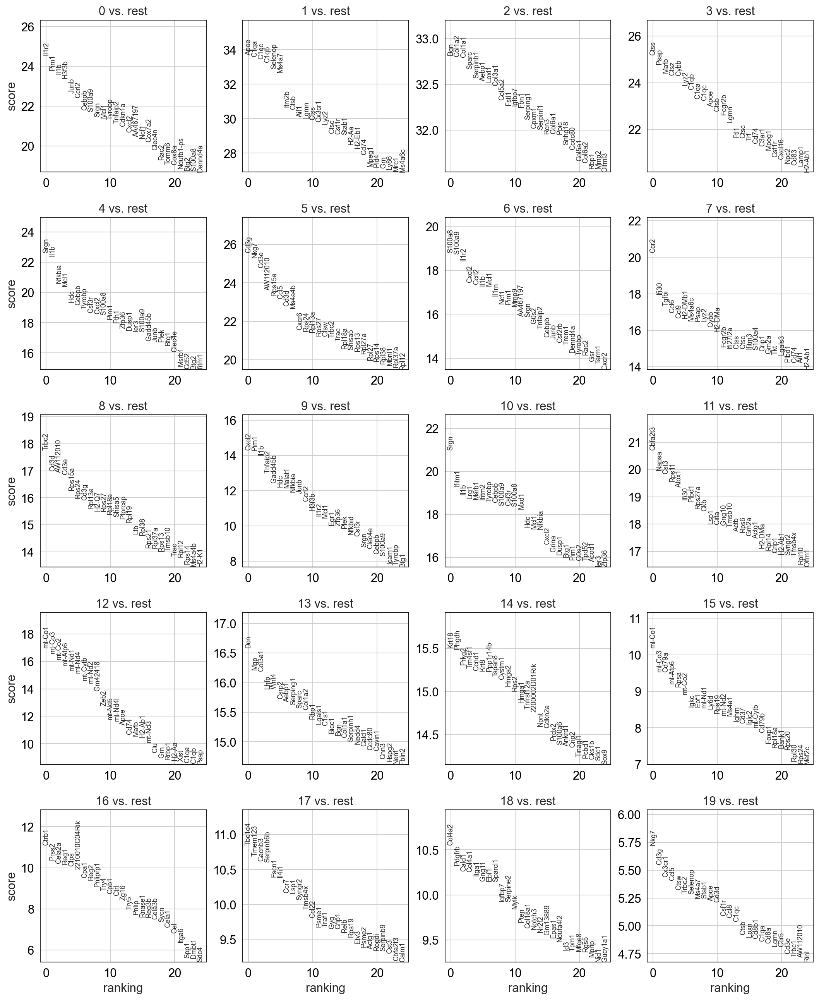

,0,1,2,3,4,5,6,7,8,9,10,11,12,13,14,15,16,17,18,19
0,Il1r2,Apoe,Bgn,Ctss,Srgn,Cd3g,S100a8,Ccr2,Trbc2,Cxcl2,Srgn,Cbfa2t3,mt-Co1,Dcn,Krt18,mt-Co1,Ctrb1,Tbc1d4,Col4a2,Nkg7
1,Pim1,C1qa,Col1a2,Psap,Il1b,Nkg7,S100a9,Ifi30,Cd3d,Pim1,Ifitm1,Napsa,mt-Co3,Mgp,Phgdh,mt-Co3,Prss2,Tmem123,Pdgfrb,Cd3g
2,Il1b,C1qc,Col1a1,Mafb,Nfkbia,Cd3e,Il1r2,Tgfbi,AW112010,Il1b,Il1b,Cst3,mt-Co2,Col3a1,Prkg2,Cd79a,Cela2a,Cacnb3,Cald1,Cx3cr1
3,H3f3b,C1qb,Sparc,Ctsz,Mcl1,AW112010,Cxcl2,Ccl6,Cd3e,Tnfaip2,Lrg1,Rps11,mt-Atp6,Lhfp,Tm4sf1,mt-Atp6,Reg1,Serpinb6b,Col4a1,Ccl5
4,Junb,Selenop,Serpinh1,Cybb,Hdc,Rps15a,Ccrl2,Ccl9,Rps15a,Gadd45b,Msrb1,Atox1,mt-Nd1,Wnt4,Ccnd1,Rpsa,Clps,Fscn1,Itga1,Ctsw
5,Ccrl2,Ms4a7,Aebp1,Lyz2,Cebpb,Ccl5,Il1b,H2-DMb1,Rps24,Hdc,Ifitm2,Ifi30,mt-Nd4,Csrp2,Krt8,mt-Co2,2210010C04Rik,Il4i1,Gng11,Trbc2
6,Cebpb,Itm2b,Loxl1,C1qb,Tyrobp,Cd3d,Mcl1,Ms4a6c,Cd3g,Malat1,Tyrobp,Plbd1,mt-Cytb,Aebp1,Ppp1r14b,Igkc,Cpa1,Ccr7,Ebf1,Selenop
7,S100a9,Ctsb,Col3a1,C1qa,Csf3r,Ms4a4b,Il1rn,Psap,Rpl13a,Nfkbia,Cebpb,Rps27a,mt-Nd2,Serping1,Tspan8,Ebf1,Reg2,Lsp1,Sparcl1,Ms4a7
8,Srgn,Aif1,Col5a2,C1qc,Cxcl2,Cxcr6,Ncf1,Lyz2,H2-Q7,Junb,S100a9,Ckb,Gm42418,Sparc,Cystm1,mt-Nd1,Pnliprp1,Syngr2,Igfbp7,Stab1
9,Mcl1,Lgmn,Fstl1,Apoe,S100a8,Rps24,Pim1,Cybb,Rps27,Ccrl2,Csf3r,Lsp1,Zeb2,Col1a2,Hmga2,Ly6d,Try4,Tmsb4x,Serpine2,Apoe


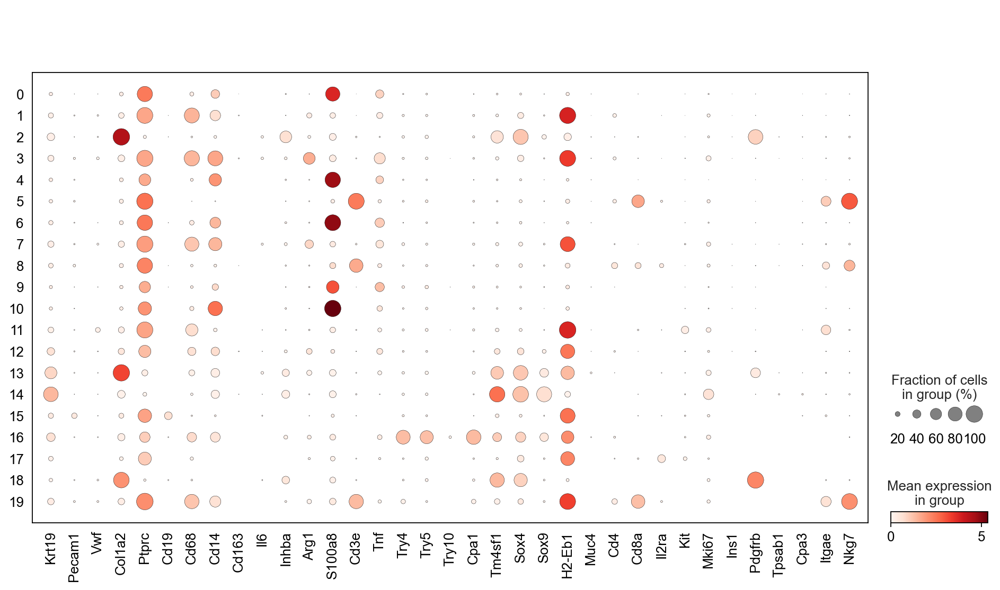

G12R


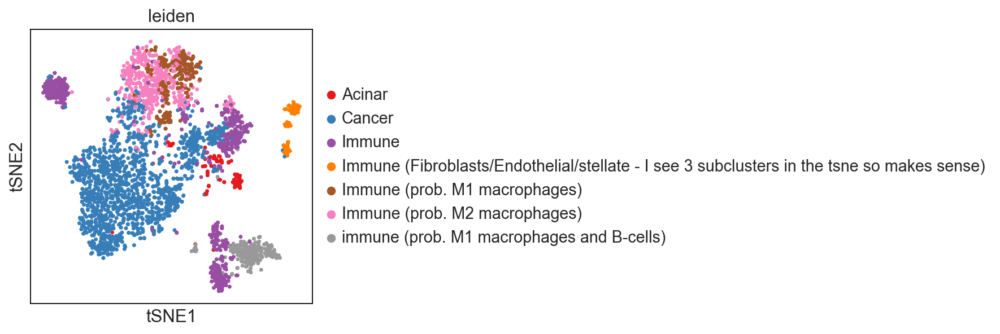

running Leiden clustering
    finished (0:00:00)
computing tSNE
    using 'X_pca' with n_pcs = 50
    using sklearn.manifold.TSNE
    finished (0:00:04)


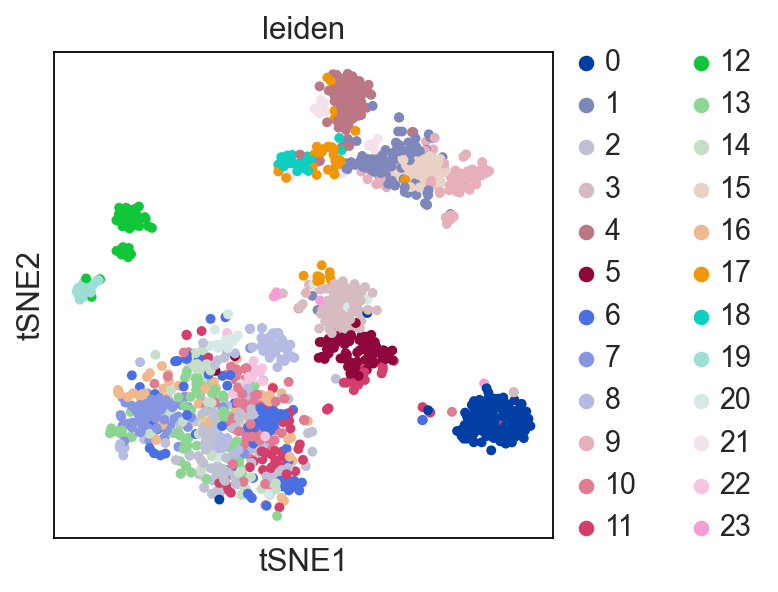

ranking genes
    finished (0:00:05)


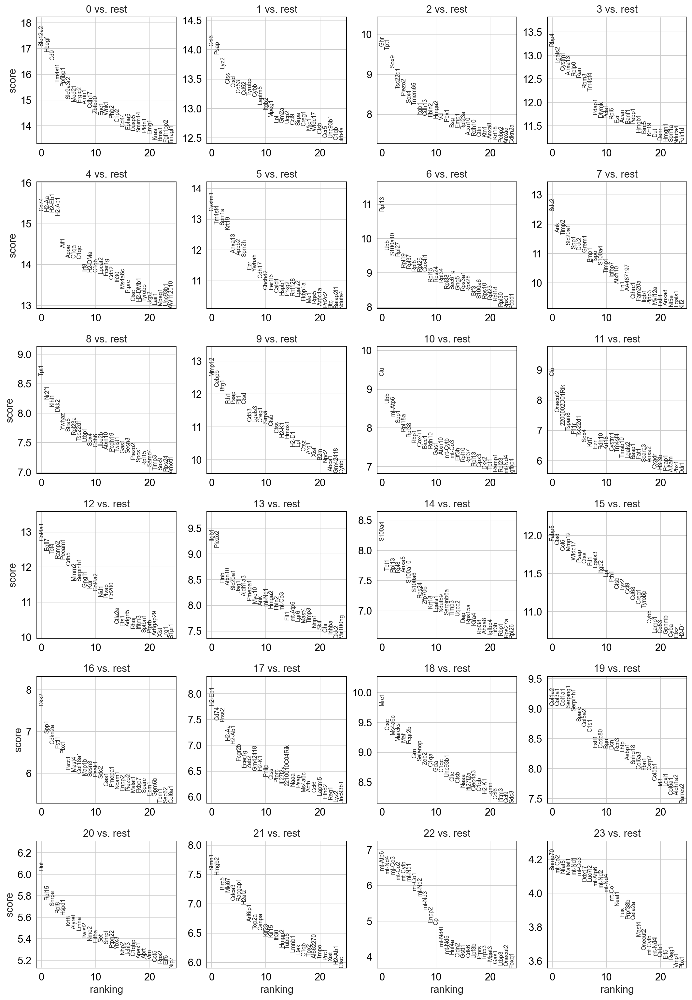

,0,1,2,3,4,5,6,7,8,9,10,11,12,13,14,15,16,17,18,19,20,21,22,23
0,Slc12a2,Ccl6,Ghr,Rbp4,Cd74,Cystm1,Rpl13,Sdc2,Tpt1,Mmp12,Clu,Clu,Col4a1,Itgb1,S100a4,Fabp5,Dkk2,H2-Eb1,Mrc1,Col1a2,Dut,Stmn1,mt-Atp6,Snrnp70
1,Hbegf,Psap,Tpt1,Lgals2,H2-Aa,Tm4sf4,Ubb,Ank,Nr2f1,Cebpb,Ubb,Onecut2,Egfl7,Piezo2,Tpt1,Ctsd,Spp1,Cd74,Ctsc,Col3a1,Rpl15,Hmgb2,mt-Nd4,mt-Co2
2,Cd9,Lyz2,Sox9,Cystm1,H2-Eb1,Sprr1a,S100a10,Timp2,Klhl1,Btg1,mt-Atp6,2200002D01Rik,Tcf4,Flnb,Rpl13,Ccl6,Cdkn2a,Prss2,Ms4a6c,Col1a1,Snrpe,Birc5,mt-Co3,Nfat5
3,Tm4sf1,Ctss,Tsc22d1,Anxa13,H2-Ab1,Krt19,Rpl27,Slc20a1,Dkk2,Fth1,Spp1,Tspan8,Ramp2,Atxn10,Rpl8,Mmp12,Fstl1,H2-Aa,Marcks,Serping1,Rpl8,Mki67,mt-Co2,Malat1
4,Ppfibp1,Ctsd,Piezo2,Rplp0,Aif1,Anxa13,Rpl19,Spp1,Ywhaz,Psap,Rpl18a,F11r,Pecam1,Slc20a1,Anxa5,Wfdc17,Pbx1,H2-Ab1,Maf,Serpinh1,Hspd1,Cdca3,mt-Cytb,mt-Nd1
5,Slc9a3r2,Cd53,Sox4,Ran,Apoe,Apbb2,Rpl37,Dkk2,Stra6,Ftl1,Rpl38,Tsc22d1,Cdh5,Jag1,S100a10,Psap,Bicc1,Fcgr2b,Fcgr2b,Sparc,Krt8,Racgap1,mt-Nd1,mt-Co3
6,Med21,Cd52,Tmem65,Rbm3,C1qa,Sprr2h,Rpl8,Grem1,Rpl23a,Ctsd,Rbp1,Sox4,Mmrn2,Aldh1a3,S100a6,Ctss,Mast4,Fcer1g,Grn,Col5a2,Alyref,H2afz,mt-Co1,Ddx17
7,Ergic2,Tyrobp,Itgb1,Tm4sf4,C1qc,Ezr,Rpl26,Bmp1,Tsc22d1,Cd53,Cox4i1,Krt7,Serpinh1,Pmepa1,Rps24,Ftl1,Col18a1,Zeb2,Selenop,C1s1,Lmna,Arl6ip1,mt-Nd2,Luc7l2
8,Amn1,Cybb,Cdh13,Pdap1,Irf8,Ywhah,Cox4i1,Tspo,Ltbp1,Lgals3,Bicc1,Ezr,Gng11,Myo10,Zfp706,Lgals3,Map1b,Gm42418,Zeb2,Fstl1,Twist2,Top2a,mt-Nd3,mt-Atp6
9,Cdh17,Laptm5,Fbln2,Dtymk,H2-DMa,Cdh17,Rpl15,S100a4,Sox4,Creg1,Rdh10,Rdh10,Kdr,Ank,Krt18,Itgb2,Sesn3,H2-K1,C1qa,Ccdc80,Nme2,Cenpa,Enpp2,mt-Nd2


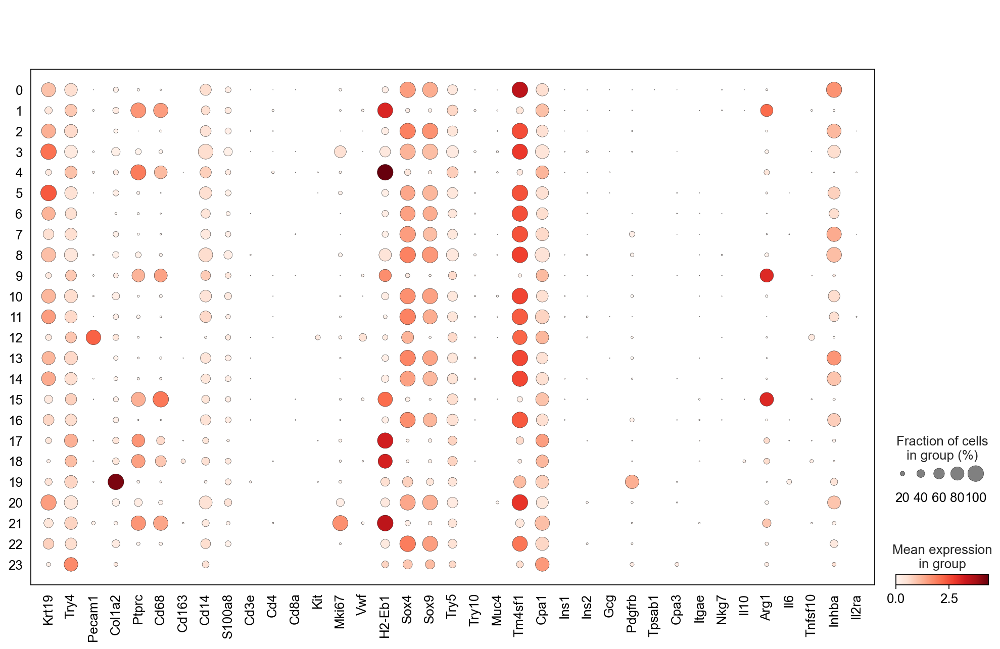

In [8]:
for cond in conditions:
    if cond == 'G12C':
        print('G12C')
        G12C = reannotate_and_visualize_clusters(G12C, G12C_clusters)
        G12C_immune = subset_analysis(G12C, 'immune')
        G12C_immune, G12C_immune_top_genes_df = markers(G12C_immune)
        display(G12C_immune_top_genes_df)
        sc.pl.dotplot(G12C_immune, marker_genes_immune, groupby='leiden')
    if cond == 'G12D':
        print('G12D')
        G12D = reannotate_and_visualize_clusters(G12D, G12D_clusters)
        G12D_immune = subset_analysis(G12D, 'immune')
        G12D_immune, G12D_immune_top_genes_df = markers(G12D_immune)
        display(G12D_immune_top_genes_df)
        sc.pl.dotplot(G12D_immune, marker_genes_immune, groupby='leiden')
    if cond == 'G12R':
        print('G12R')
        G12R = reannotate_and_visualize_clusters(G12R, G12R_clusters)
        G12R_immune = subset_analysis(G12R, 'immune', resolution=2)
        G12R_immune, G12R_immune_top_genes_df = markers(G12R_immune)
        display(G12R_immune_top_genes_df)
        sc.pl.dotplot(G12R_immune, marker_genes, groupby='leiden')

## Immune clusters mapping by marker genes

In [9]:
G12C_immune_clusters = {
    0: 'Macrophages M2',
    1: 'Macrophages M2', 
    2: 'Macrophages M2',
    3: 'MDSCs',
    4: 'MDSCs',
    5: 'Macrophages M2',
    6: 'MDSCs',
    7: 'Macrophages M2',
    8: 'Macrophages M2',
    9: 'B-cells',
    10: 'MDSCs',
    11: 'B-cells',
    12: 'Cd4 T-cells',
    13: 'Cd8 T-cells', 
    14: 'MDSCs',
    15: 'MDSCs',
    16: 'Macrophages M2'
}


G12D_immune_clusters = {
    0: 'MDSCs',
    1: 'MDSCs',
    2: 'Fibroblasts',
    3: 'Macrophages M1',
    4: 'MDSCs',
    5: 'Cd8 T-cells',
    6: 'MDSCs',
    7: 'MDSCs',
    8: 'Cd4 T-cells',
    9: 'B-cells', 
    10: 'MDSCs',
    11: 'B-cells',
    12: 'B-cells',
    13: 'Fibroblasts',
    14: 'Cancer',
    15: 'B-cells',
    16: 'Acinar',
    17: 'B-cells',
    18: 'Fibroblasts',
    19: 'Cd8 T-cells'
}


G12R_immune_clusters = {
    0: 'Macrophages M1',
    1: 'B-cells', 
    2: 'Cancer',
    3: 'MDSCs',
    4: 'B-cells',
    5: 'Cancer',
    6: 'Cancer',
    7: 'Cancer',
    8: 'Cancer',
    9: 'Macrophages M2',
    10: 'Cancer',
    11: 'Cancer',
    12: 'Endothelial',
    13: 'Cancer', 
    14: 'Cancer',
    15: 'Macrophages M2',
    16: 'Cancer',
    17: 'B-cells',
    18: 'B-cells',
    19: 'Fibroblasts',
    20: 'Cancer',
    21: 'B-cells',
    22: 'Cancer',
    23: 'Cancer'
}

## Immune cells re-mapping and TSNE after cluster annotations

G12C
G12D
G12R


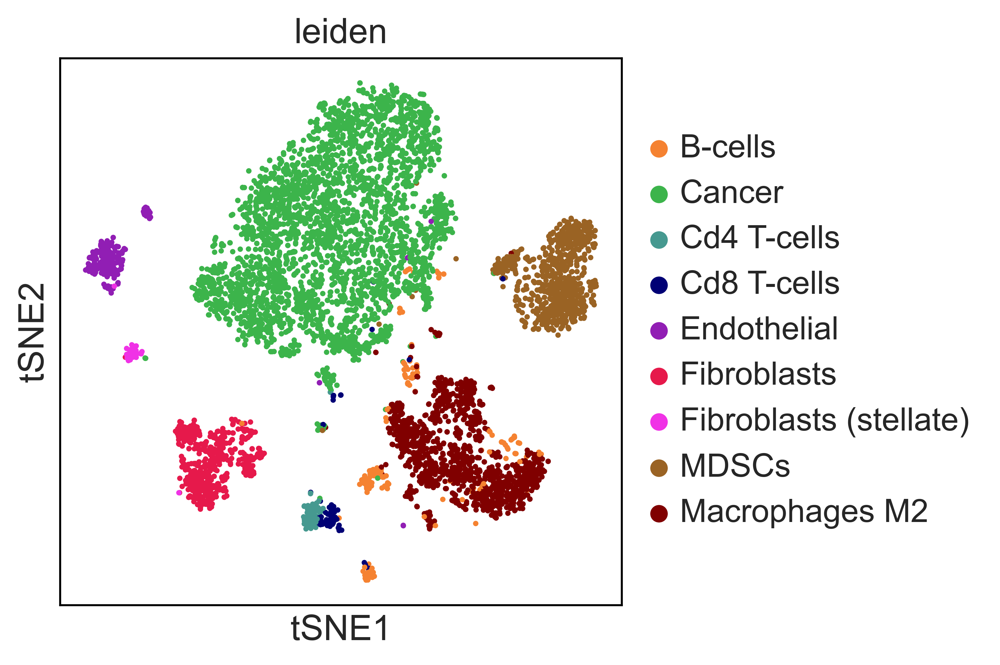

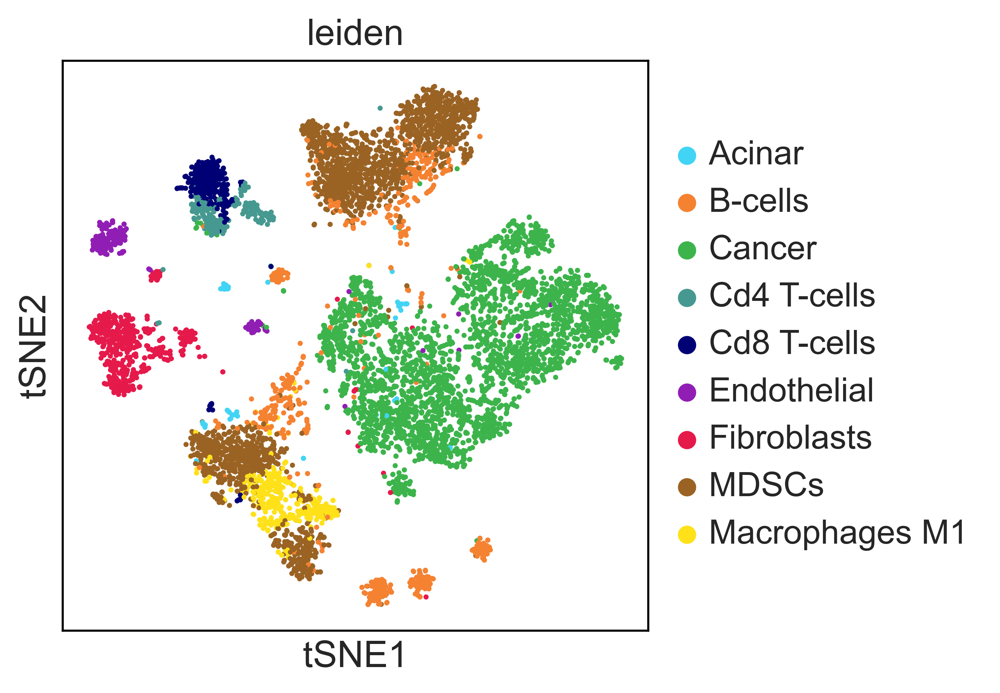

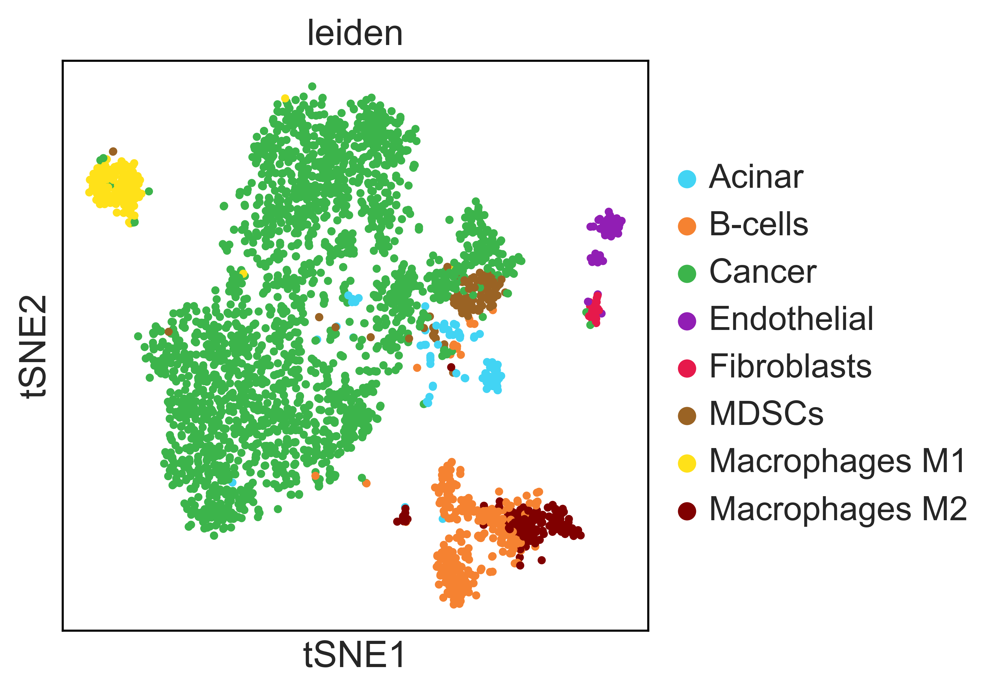

In [10]:
for cond in conditions:
    if cond == 'G12C':
        print('G12C')
        G12C, G12C_fig = reannotate_subset_and_visualize(G12C, G12C_immune, G12C_immune_clusters, palette=colors)
        G12C_fig.dpi =300
    if cond == 'G12D':
        print('G12D')
        G12D, G12D_fig = reannotate_subset_and_visualize(G12D, G12D_immune, G12D_immune_clusters, palette=colors)
        G12D_fig.dpi =300
    if cond == 'G12R':
        print('G12R')
        G12R, G12R_fig = reannotate_subset_and_visualize(G12R, G12R_immune, G12R_immune_clusters, palette=colors)
        G12R_fig.dpi =300

## Save TSNE plots

In [11]:
#G12C_fig.savefig(f'G12C.pdf')       
#G12D_fig.savefig(f'G12D.pdf')
#G12R_fig.savefig(f'G12R.pdf')

## Pathway analysis

In [12]:
go_path = 'data/pathways/mh.all.v2023.2.Mm.symbols.gmt'
go_sets = pd.DataFrame.from_dict(gp.read_gmt(go_path),orient='index')

cond_obj_dict = {'G12C': G12C,
                 'G12D': G12D,
                 'G12R': G12R}

df_g12c = pd.DataFrame()
df_g12d = pd.DataFrame()
df_g12r = pd.DataFrame()

cond_path_dict = {'G12C': df_g12c,
                  'G12D': df_g12d,
                  'G12R': df_g12r}

for pathway in go_sets.index:
    genes = go_sets.loc[pathway,:].dropna().to_list()
    
    for cond, obj in cond_obj_dict.items():
        print(f'\n\nCondition: {cond}, Pathway: {pathway}')
        df_path = pathway_preprocess(cond_obj_dict[cond], pathway, genes)
        cond_path_dict[cond] = cond_path_dict[cond].merge(df_path, left_index=True, right_index=True, how='right')



Condition: G12C, Pathway: HALLMARK_ADIPOGENESIS
adata shape: (6389, 949)
raw adata shape: (6389, 19709)
Number of genes in pathway: 200
Number of pathway genes in DF: 198
Number of cancer cells: 3359
Shape of cancer pathway DF: (3359, 198)


Condition: G12D, Pathway: HALLMARK_ADIPOGENESIS
adata shape: (7694, 1022)
raw adata shape: (7694, 19989)
Number of genes in pathway: 200
Number of pathway genes in DF: 196
Number of cancer cells: 3312
Shape of cancer pathway DF: (3312, 196)


Condition: G12R, Pathway: HALLMARK_ADIPOGENESIS
adata shape: (3070, 952)
raw adata shape: (3070, 17980)
Number of genes in pathway: 200
Number of pathway genes in DF: 195
Number of cancer cells: 2242
Shape of cancer pathway DF: (2242, 195)


Condition: G12C, Pathway: HALLMARK_ALLOGRAFT_REJECTION
adata shape: (6389, 949)
raw adata shape: (6389, 19709)
Number of genes in pathway: 192
Number of pathway genes in DF: 185
Number of cancer cells: 3359
Shape of cancer pathway DF: (3359, 185)


Condition: G12D, Pathw

In [13]:
df_g12c = cond_path_dict['G12C']
df_g12d = cond_path_dict['G12D']
df_g12r = cond_path_dict['G12R']

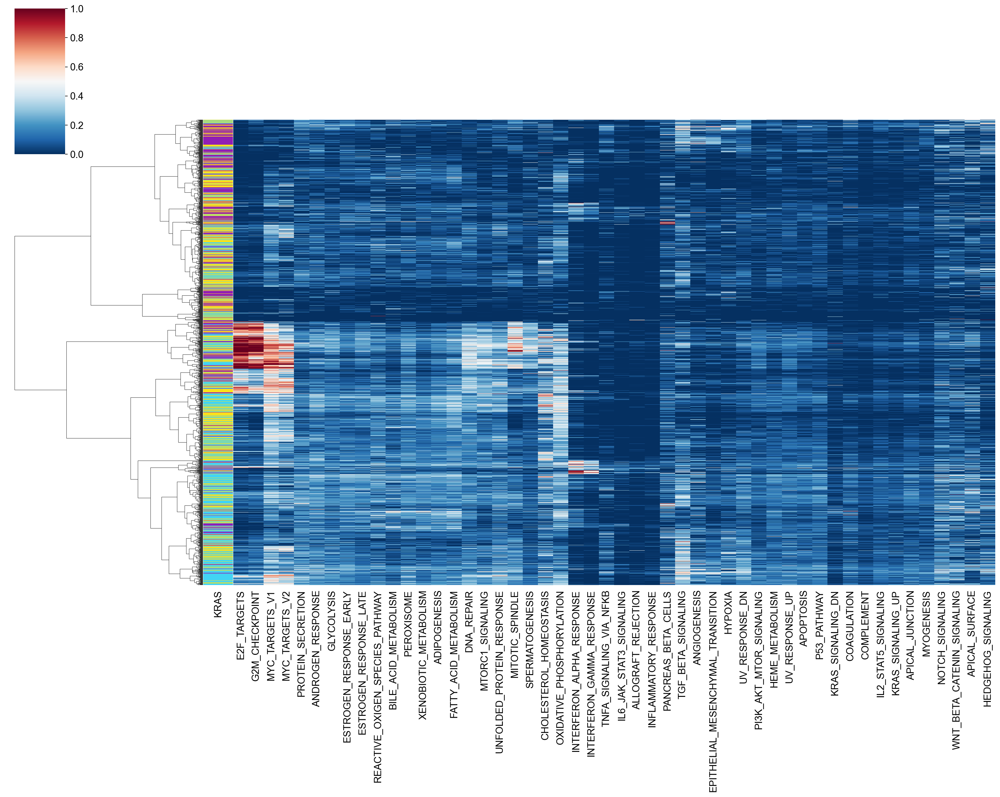

In [18]:
df_to_plot = pd.concat([df_g12c,df_g12r,df_g12d])
df_to_plot.columns = df_to_plot.columns.str[9:]

df_to_plot.loc[df_g12c.index,'KRAS'] = 'G12C'
df_to_plot.loc[df_g12r.index,'KRAS'] = 'G12R'
df_to_plot.loc[df_g12d.index,'KRAS'] = 'G12D'


lut = dict(zip(df_to_plot['KRAS'].unique(), ['#ffe119', '#911eb4', '#42d4f4']))
row_colors = df_to_plot['KRAS'].map(lut)
df_to_plot.drop(columns='KRAS',inplace=True)

cg = sns.clustermap(df_to_plot,method='ward',cmap='RdBu_r',row_colors=row_colors,
                     vmax=1,vmin=0,xticklabels=True,yticklabels=False, figsize=(20,16));

#cg.ax_row_dendrogram.set_visible(False)
cg.ax_col_dendrogram.set_visible(False)

In [ ]:
#cg.savefig(f'output/pathway_heatmap.png', dpi=150, bbox_inches='tight')

# Heatmap without G12C

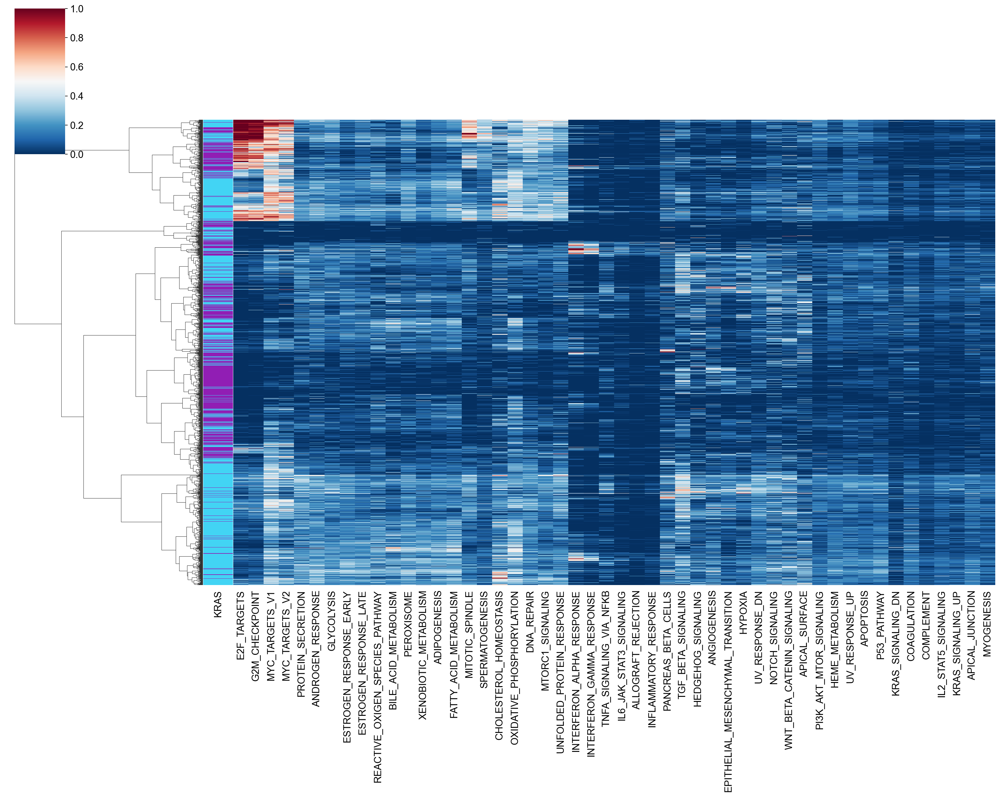

In [22]:
df_to_plot = pd.concat([df_g12r,df_g12d])
df_to_plot.columns = df_to_plot.columns.str[9:]

df_to_plot.loc[df_g12r.index,'KRAS'] = 'G12R'
df_to_plot.loc[df_g12d.index,'KRAS'] = 'G12D'


lut = dict(zip(df_to_plot['KRAS'].unique(), ['#911eb4', '#42d4f4']))
row_colors = df_to_plot['KRAS'].map(lut)
df_to_plot.drop(columns='KRAS',inplace=True)

cg = sns.clustermap(df_to_plot,method='ward',cmap='RdBu_r',row_colors=row_colors,
                     vmax=1,vmin=0,xticklabels=True,yticklabels=False, figsize=(20,16));

cg.ax_col_dendrogram.set_visible(False)

In [16]:
#cg.savefig(f'output/pathway_heatmap_no_g12c.pdf', dpi=150, bbox_inches='tight')

# P-value calculation (hypergeometric)

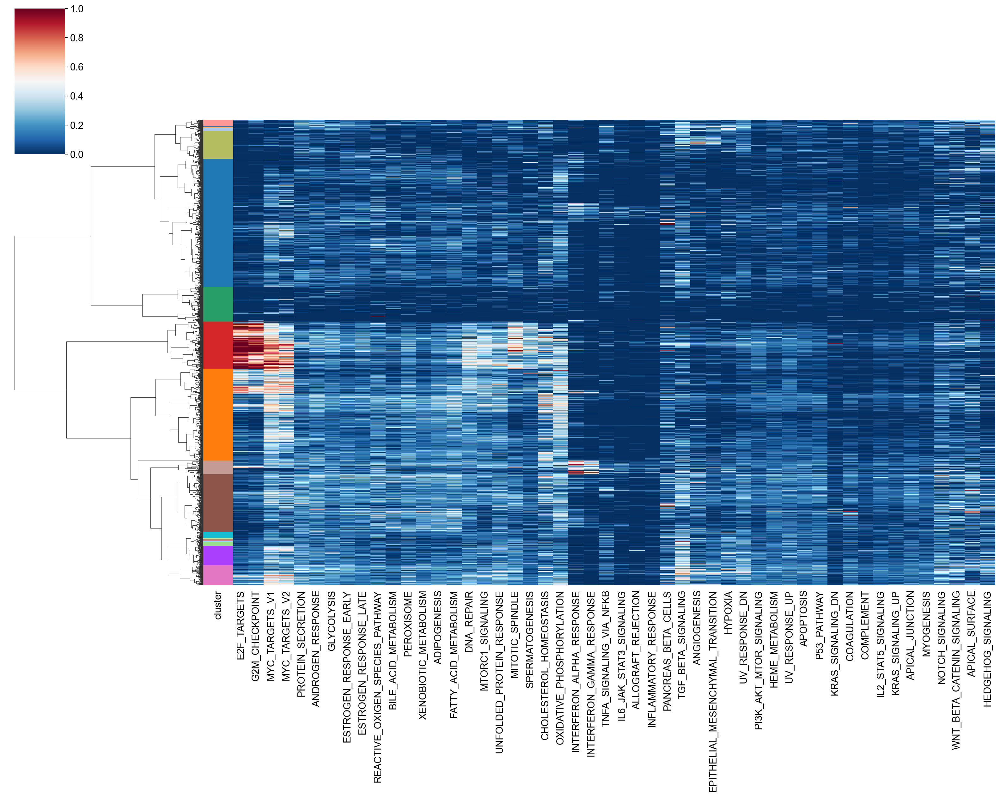

In [52]:
from scipy.cluster import hierarchy
from scipy.spatial import distance

df_to_plot = pd.concat([df_g12c,df_g12r,df_g12d])
df_to_plot.columns = df_to_plot.columns.str[9:]

row_linkage = hierarchy.linkage(
    distance.pdist(df_to_plot), method='ward')

clusters_mb = pd.DataFrame(data=fcluster(row_linkage,1.15470044),index =df_to_plot.index,columns=['cluster'])

df_to_plot = pd.merge(df_to_plot,clusters_mb,left_index=True,right_index=True)


lut = dict(zip(clusters_mb['cluster'].unique(),sns.color_palette(n_colors=clusters_mb['cluster'].nunique())))
row_colors = clusters_mb['cluster'].map(lut)

df_to_plot.drop(columns='cluster',inplace=True)

col_linkage = hierarchy.linkage(
    distance.pdist(df_to_plot.T), method='ward')

cg = sns.clustermap(df_to_plot,method='ward',cmap='RdBu_r',row_colors=row_colors, 
                    row_linkage=row_linkage, col_linkage=col_linkage,
                     vmax=1,vmin=0,xticklabels=True,yticklabels=False, figsize=(20,16));

row_colors
#cg.ax_row_dendrogram.set_visible(False)
cg.ax_col_dendrogram.set_visible(False)


In [43]:
df_p = df_to_plot.merge(clusters_mb, left_index=True, right_index=True)
df_p.loc[df_g12c.index,'KRAS'] = 'G12C'
df_p.loc[df_g12r.index,'KRAS'] = 'G12R'
df_p.loc[df_g12d.index,'KRAS'] = 'G12D'

df_p.groupby('cluster').mean()

,ADIPOGENESIS,ALLOGRAFT_REJECTION,ANDROGEN_RESPONSE,ANGIOGENESIS,APICAL_JUNCTION,APICAL_SURFACE,APOPTOSIS,BILE_ACID_METABOLISM,CHOLESTEROL_HOMEOSTASIS,COAGULATION,COMPLEMENT,DNA_REPAIR,E2F_TARGETS,EPITHELIAL_MESENCHYMAL_TRANSITION,ESTROGEN_RESPONSE_EARLY,ESTROGEN_RESPONSE_LATE,FATTY_ACID_METABOLISM,G2M_CHECKPOINT,GLYCOLYSIS,HEDGEHOG_SIGNALING,HEME_METABOLISM,HYPOXIA,IL2_STAT5_SIGNALING,IL6_JAK_STAT3_SIGNALING,INFLAMMATORY_RESPONSE,INTERFERON_ALPHA_RESPONSE,INTERFERON_GAMMA_RESPONSE,KRAS_SIGNALING_DN,KRAS_SIGNALING_UP,MITOTIC_SPINDLE,MTORC1_SIGNALING,MYC_TARGETS_V1,MYC_TARGETS_V2,MYOGENESIS,NOTCH_SIGNALING,OXIDATIVE_PHOSPHORYLATION,P53_PATHWAY,PANCREAS_BETA_CELLS,PEROXISOME,PI3K_AKT_MTOR_SIGNALING,PROTEIN_SECRETION,REACTIVE_OXIGEN_SPECIES_PATHWAY,SPERMATOGENESIS,TGF_BETA_SIGNALING,TNFA_SIGNALING_VIA_NFKB,UNFOLDED_PROTEIN_RESPONSE,UV_RESPONSE_DN,UV_RESPONSE_UP,WNT_BETA_CATENIN_SIGNALING,XENOBIOTIC_METABOLISM
cluster,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,
1,0.069694,-0.079029,0.177442,0.122203,0.124269,0.266835,0.065850,0.116919,0.069812,0.077553,0.041951,-0.024087,-0.057264,0.070053,0.166739,0.124304,0.046213,0.012848,0.104803,0.262540,0.101473,0.092954,0.073125,-0.038103,0.000340,-0.022438,-0.057307,0.035211,0.053603,0.147632,0.017545,-0.054084,-0.066665,0.075681,0.076393,-0.067451,0.065589,0.050893,0.091872,0.036949,0.192281,0.022959,0.047581,0.207808,-0.006043,0.036457,0.178301,0.035281,0.121014,0.116111
2,0.104587,0.104849,0.085404,0.629516,0.198796,0.117057,0.220954,0.082209,-0.060619,0.385358,0.120061,0.042010,-0.095915,0.897976,0.093988,0.063807,-0.016058,-0.115283,0.103040,0.186756,0.012347,0.155116,0.174168,0.173188,0.048315,0.210658,0.184506,0.055115,0.119971,-0.016318,-0.047168,-0.012188,-0.127418,0.399658,0.117630,0.076493,0.038448,-0.030498,0.063586,0.029244,0.118180,0.059631,0.045630,0.138179,0.049624,0.044710,0.292342,0.021299,0.151268,0.084190
3,-0.048673,0.049016,0.144415,0.666511,0.133773,0.105062,0.237652,-0.025617,0.031085,0.281610,0.119536,-0.064375,-0.156637,0.677915,0.097038,0.084213,-0.015559,-0.121415,0.104607,0.082531,0.068761,0.274075,0.157306,0.123312,0.113727,-0.070205,-0.021495,0.045503,0.064749,0.109162,0.019173,-0.081460,-0.127108,0.273875,0.168457,-0.129970,0.103550,-0.047085,0.040998,0.068839,0.108308,-0.012132,-0.082777,0.494906,0.294363,0.047156,0.289459,0.066928,0.174973,-0.005794
4,0.003000,0.010014,0.117356,0.306250,0.125210,0.007917,0.129944,-0.028307,0.003232,0.226606,0.039092,0.058071,-0.052136,0.597701,0.047196,0.055829,-0.011907,-0.057103,0.109345,0.045344,0.017779,0.162456,0.054140,-0.035107,0.022921,-0.152369,-0.151521,0.065524,0.023431,0.145857,0.045429,0.120767,0.036804,0.190412,-0.006438,0.057585,0.093004,0.058584,0.066503,0.046751,0.106072,0.021627,0.061364,0.513104,0.196448,0.090380,0.256914,0.153392,0.181018,0.003776
5,0.100681,0.004399,0.165333,0.516537,0.136454,-0.007634,0.184956,0.068636,0.354567,0.177036,0.069853,0.091724,-0.210228,0.498136,-0.004819,0.039114,0.180890,-0.145311,0.000545,0.243427,0.022000,0.045226,0.023414,-0.073361,0.074056,-0.165550,-0.144945,0.025821,0.067540,0.006647,0.089606,0.061359,-0.069598,0.239196,0.195453,0.211319,-0.002788,0.132162,0.091563,0.141380,0.111273,-0.062479,-0.125386,0.351161,0.070345,0.076558,0.213195,0.066021,0.203033,-0.037133
6,0.034046,0.092239,0.187014,0.437297,0.101821,-0.035570,0.190565,0.019939,0.550629,0.143503,0.102867,0.056055,-0.023017,0.500551,0.016346,0.044527,0.102499,-0.017868,0.135415,0.034258,0.029513,0.177614,0.115369,0.002235,0.100022,-0.081834,-0.041011,0.017862,0.090378,0.050748,0.140145,0.195682,0.103807,0.204104,0.079025,0.113016,0.115554,-0.047943,0.092196,0.153090,0.005659,0.163289,-0.033287,0.357422,0.421931,0.040028,0.189521,0.113158,0.008616,-0.011133
7,0.002836,-0.071966,0.108433,0.184236,0.043474,0.018008,0.119803,0.018088,0.068478,0.043074,0.018645,-0.003121,-0.070950,0.200195,0.140837,0.072536,-0.011660,0.016872,0.177665,0.250368,0.117568,0.367303,0.101147,-0.069524,-0.010594,-0.086401,-0.10

In [56]:
from scipy.stats import hypergeom
df_13 = df_p[df_p['cluster'] == 13]

[x, M, n, N] = [df_13[df_13['KRAS']=='G12R'].shape[0] ,df_p.shape[0], df_13.shape[0], df_p[df_p['KRAS']=='G12R'].shape[0]]
prb = hypergeom.cdf(x, M, n, N)
1-prb

0.0009669256389160941

## Filter for cancer cells

In [ ]:
for cond in conditions:
    if cond == 'G12C':
        print('G12C')
        G12C_cancer = subset_analysis(G12C, 'cancer', resolution=0.25)
        G12C_cancer, top_genes_df_c = markers(G12C_cancer)
    if cond == 'G12D':
        print('G12D')
        G12D_cancer = subset_analysis(G12D, 'cancer', resolution=0.25)
        G12D_cancer, top_genes_df_d = markers(G12D_cancer)
    if cond == 'G12R':
        print('G12R')
        G12R_cancer = subset_analysis(G12R, 'cancer', resolution=0.25)
        G12R_cancer, top_genes_df_r = markers(G12R_cancer)

## Cancer cells GSEA analysis

In [ ]:
cancer_adata_objs = {'G12C': G12C_cancer, 
                     'G12D': G12D_cancer} 
                     #,'G12R': G12R_cancer}

for cond, obj in cancer_adata_objs.items():
    clusters = obj.obs['leiden'].unique()
    for cluster in clusters:
        df = pval_and_effect_df(obj, int(cluster))
        df_diff = differential_genes(df)
        gsea_plot(df_diff, f'{cond} with cluster {cluster}:\n')